# KDD 2010

## Preliminaries

### Import Packages

In [1]:
from utilities import * 

### Constants

In [2]:
# paths
PATH_TO_INTERACTION_DATA = '../../../../../data/ddia/kdd_2010/algebra_2005_2006_train.txt'

# dataset name
DATASET_NAME = 'kdd_2010'

# fields used in the analysis
USER_FIELD = 'Anon Student Id'
GROUP_FIELD = 'Problem Hierarchy'
LEARNING_ACTIVITY_FIELD = 'Problem Name'
COURSE_FIELD = 'Course'
TIMESTAMP_FIELD = 'Step Start Time'

# fields used in dataset preparation
INCORRECTS_FIELD = 'Incorrects'
HINTS_FIELD = 'Hints'
CORRECT_TRANSACTION_TIME_FIELD = 'Correct Transaction Time'
CORRECT_FIRST_ATTEMPT_FIELD = 'Correct First Attempt'
STEP_DURATION_FIELD = 'Step Duration (sec)'

# strings and values used in dataset preparation

# evaluation fields
# learning activity level
EVALUATION_LEARNING_ACTIVITY_SCORE_FIELD = None
EVALUATION_LEARNING_ACTIVITY_IS_CORRECT_FIELD = None
# group level
EVALUATION_GROUP_SCORE_FIELD = None
EVALUATION_GROUP_IS_CORRECT_FIELD = None 
# course level
EVALUATION_COURSE_SCORE_FIELD = None
EVALUATION_COURSE_IS_CORRECT_FIELD = None 

# score threshold is correct
EVALUATION_LEARNING_ACTIVITY_SCORE_CORRECT_THRESHOLD = None
EVALUATION_GROUP_SCORE_CORRECT_THRESHOLD = None
EVALUATION_COURSE_SCORE_CORRECT_THRESHOLD = None

# evaluation min and max in dataset docu
EVALUATION_LEARNING_ACTIVITY_SCORE_MINIMUM_IN_DATASET_DOCU = None
EVALUATION_LEARNING_ACTIVITY_SCORE_MAXIMUM_IN_DATASET_DOCU = None
EVALUATION_GROUP_SCORE_MINIMUM_IN_DATASET_DOCU = None
EVALUATION_GROUP_SCORE_MAXIMUM_IN_DATASET_DOCU = None
EVALUATION_COURSE_SCORE_MINIMUM_IN_DATASET_DOCU = None
EVALUATION_COURSE_SCORE_MAXIMUM_IN_DATASET_DOCU = None

# used for generating html tables
HTML_TABLES_DATA_LIST = [[LEARNING_ACTIVITY_FIELD, EVALUATION_LEARNING_ACTIVITY_SCORE_FIELD, EVALUATION_LEARNING_ACTIVITY_IS_CORRECT_FIELD, EVALUATION_LEARNING_ACTIVITY_SCORE_CORRECT_THRESHOLD, EVALUATION_LEARNING_ACTIVITY_SCORE_MINIMUM_IN_DATASET_DOCU, EVALUATION_LEARNING_ACTIVITY_SCORE_MAXIMUM_IN_DATASET_DOCU], 
                         [GROUP_FIELD, EVALUATION_GROUP_SCORE_FIELD, EVALUATION_GROUP_IS_CORRECT_FIELD, EVALUATION_GROUP_SCORE_CORRECT_THRESHOLD, EVALUATION_GROUP_SCORE_MINIMUM_IN_DATASET_DOCU, EVALUATION_GROUP_SCORE_MAXIMUM_IN_DATASET_DOCU], 
                         [COURSE_FIELD, EVALUATION_COURSE_SCORE_FIELD, EVALUATION_COURSE_IS_CORRECT_FIELD, EVALUATION_COURSE_SCORE_CORRECT_THRESHOLD, EVALUATION_COURSE_SCORE_MINIMUM_IN_DATASET_DOCU, EVALUATION_COURSE_SCORE_MAXIMUM_IN_DATASET_DOCU]]

### Import Pickled Objects

In [3]:
# seq_distances = pickle_read(PATH_TO_SEQUENCE_DISTANCES_PICKLE_FOLDER,
#                             DATASET_NAME + SEQUENCE_DISTANCE_DICT_PER_GROUP_PICKLE_NAME)

# learning_activity_sequence_stats_per_group = pickle_read(PATH_TO_SEQUENCE_STATISTICS_PICKLE_FOLDER,
#                                                          DATASET_NAME + SEQUENCE_STATISTICS_TABLES_PICKLE_NAME)

# html_table = pickle_read(PATH_TO_HTML_TABLES_PICKLE_FOLDER,
#                          DATASET_NAME + HTML_TABLES_PICKLE_NAME)

# cluster_eval = pickle_read(PATH_TO_SEQUENCE_CLUSTER_EVALUATION_METRIC_ANALYSIS_PICKLE_FOLDER,
#                            DATASET_NAME + SEQUENCE_CLUSTER_EVALUATION_METRIC_ANALYSIS_PER_GROUP_OBJECT_PICKLE_NAME)

### Functions

In [4]:
def calculate_eval_metrics(df: pd.DataFrame,
                           incorrects_field=None,
                           hints_field=None,
                           correct_transaction_time_field=None,
                           correct_first_attempt_field=None,
                           step_duration_field=None):
    """Calculate evaluation metrics per single learning_activity. This function should be used as input of the
    add_evaluation_fields function.

    Parameters
    ----------
    df : pd.DataFrame
        A subset of the interactions dataframe containing data of a single learning_activity
    incorrects_field : _type_
        The incorrects field, by default None
    hints_field : _type_
        The hints field, by default None
    correct_transaction_time_field : _type_
        The correct_transaction_time field, by default None
    correct_first_attempt_field : _type_
        The correct_first_attemp_field field, by default None
    step_duration_field : _type_
        The step_duration_field field, by default None

    Returns
    -------
    tuple
        A tuple of evaluation metric scalars per learning activity
    """
    df = df.copy()

    
    # generate correct field
    correct_field = 'correct'
    df[correct_field] = df[correct_transaction_time_field].notna().astype(int)

    # number interactions 
    # (Avg sum corrects + sum incorrects + sum hints)
    number_interactions_total = df[[correct_field, hints_field, incorrects_field]].apply(sum, axis=1).mean()

    # number attempts 
    # (Avg sum corrects + sum incorrects)
    number_attempts_total = df[[correct_field, incorrects_field]].apply(sum, axis=1).mean()

    # number hints  
    # (Avg number of hints)
    number_hints_total = df[hints_field].mean()

    # total time
    # (Avg time spent on step)
    time_total = df[step_duration_field].sum() 
    
    # scores
    # single score
    # (avg of correct first attempt of a step which is a boolean)
    single_score = df[correct_first_attempt_field].mean() 
    # single score 
    # (avg of correct first attempt of a step which is a boolean, hint taken equal lowest score for learning activity)
    if df[hints_field].any():
        single_score_hint_lowest = 0
    else:
        single_score_hint_lowest = df[correct_first_attempt_field].mean() 
    # single score 
    # (avg of correct first attempt of a step which is a boolean, not first attempt equal lowest)
    if not df[correct_first_attempt_field].all():
        single_score_not_first_attempt_lowest = 0
    else:
        single_score_not_first_attempt_lowest = df[correct_first_attempt_field].mean()
    # highest score
    score_highest = None
    # highest score without hint
    score_highest_without_hint = None
    # score first attempt
    score_first_attempt = None
    # score last attempt
    score_last_attempt = None
    # number interactions until highest score
    number_interactions_until_score_highest = None
    # number attempts until highest score
    number_attempts_until_score_highest = None
    # number hints until highest score
    number_hints_until_score_highest = None
    # time until highest score
    time_until_score_highest = None

    # corrects
    # correct
    # (all steps correct)
    is_correct = df[correct_field].all()
    # correct without hint
    # (all steps correct without any hint taken)
    if is_correct:
        is_correct_without_hint = not df[hints_field].any()
    else:
        is_correct_without_hint = False
    # correct first attempt
    # (all steps correct at the first attempt (may include hints taken))
    if is_correct:
        is_correct_first_attempt = not df[incorrects_field].any() 
    else:
        is_correct_first_attempt = False
    # correct first attempt without hint
    # (all steps correct at the first attempt and no hint taken)
    if is_correct:
        is_correct_first_attempt_without_hint = (not df[incorrects_field].any()) and (not df[hints_field].any())
    else:
        is_correct_first_attempt_without_hint = False
    # correct last attempt
    is_correct_last_attempt = None
    # correct last attempt without hint
    is_correct_last_attempt_without_hint = None
    # number interactions until correct
    # (Avg number of incorrects and hints over all steps)
    if is_correct:
        number_interactions_until_correct = df[[incorrects_field, hints_field]].apply(sum, axis=1).add(1).mean()
    else:
        number_interactions_until_correct = -1 # -1 means that there was no correct -> therefore also no interactions until correct
    # number attempts until correct
    # (Avg number of incorrects over all steps)
    if is_correct:
        number_attempts_until_correct = df[incorrects_field].add(1).mean()
    else:
        number_attempts_until_correct = -1 # -1 means that there was no correct -> therefore also no attempts until correct
    # number hints until correct
    # (Avg number of hints over all steps)
    number_hints_until_correct = df[hints_field].mean()
    # time until correct
    # (Avg time spent on step)
    if is_correct:
        time_until_correct = df[step_duration_field].mean()
    else:
        time_until_correct = -1 # -1 means that there was no correct -> therefore also no attempts until correct

    return (number_interactions_total,
            number_attempts_total,
            number_hints_total,
            time_total,
            single_score,
            single_score_hint_lowest,
            single_score_not_first_attempt_lowest,
            score_highest,
            score_highest_without_hint,
            score_first_attempt,
            score_last_attempt,
            number_interactions_until_score_highest,
            number_attempts_until_score_highest,
            number_hints_until_score_highest,
            time_until_score_highest,
            is_correct,
            is_correct_without_hint,
            is_correct_first_attempt,
            is_correct_first_attempt_without_hint,
            is_correct_last_attempt,
            is_correct_last_attempt_without_hint,
            number_interactions_until_correct,
            number_attempts_until_correct,
            number_hints_until_correct,
            time_until_correct)

## Dataset Preparation

### Import Data

In [5]:
interactions = pd.read_csv(PATH_TO_INTERACTION_DATA, sep='\t')

### Set Data Type

In [6]:
interactions = typecast_fields(interactions,
                               TIMESTAMP_FIELD,
                               GROUP_FIELD,
                               USER_FIELD,
                               LEARNING_ACTIVITY_FIELD)

### Merge and Filter Data

### Transform Categorical Variable Values

In [7]:
interactions, value_mapping_df = map_new_to_old_values(interactions, 
                                                       GROUP_FIELD, 
                                                       USER_FIELD, 
                                                       LEARNING_ACTIVITY_FIELD)

### Filter Sequences by NAs in Dataset 

In [8]:
pct_na = get_nas_in_data(interactions)
pct_na

Row                                            0.0 %
Anon Student Id                                0.0 %
Problem Hierarchy                              0.0 %
Problem Name                                   0.0 %
Problem View                                   0.0 %
Step Name                                      0.0 %
Step Start Time                0.11349966777572762 %
First Transaction Time                         0.0 %
Correct Transaction Time         3.192687607911137 %
Step End Time                                  0.0 %
Step Duration (sec)            0.11349966777572762 %
Correct Step Duration (sec)     23.411930926992174 %
Error Step Duration (sec)        76.70156874078356 %
Correct First Attempt                          0.0 %
Incorrects                                     0.0 %
Hints                                          0.0 %
Corrects                                       0.0 %
KC(Default)                     25.030320096233886 %
Opportunity(Default)            25.03032009623

In [9]:
interactions, na_indices_list = drop_learning_activity_sequence_if_contains_na_in_field(interactions, 
                                                                                        GROUP_FIELD, 
                                                                                        USER_FIELD, 
                                                                                        field_list=[LEARNING_ACTIVITY_FIELD, 
                                                                                                    TIMESTAMP_FIELD], 
                                                                                        field_value_tuple_filter_list=[])



Input length: 809694
Outpunt length: 743657
Number of rows removed: 66037
Percentage of rows removed: 8.1558%
--------------------------------------------------
Input number of sequences: 16118
Output number of sequences: 15448
Number of sequences removed: 670
Percentage of sequences removed: 4.1568%


In [10]:
interactions = drop_na_by_fields(interactions,
                                 field_list=[GROUP_FIELD,
                                             USER_FIELD])

Input length: 743657
Outpunt length: 743657
Number of rows removed: 0
Percentage of rows removed: 0%


In [11]:
pct_na = get_nas_in_data(interactions)
pct_na

Row                                           0.0 %
Anon Student Id                               0.0 %
Problem Hierarchy                             0.0 %
Problem Name                                  0.0 %
Problem View                                  0.0 %
Step Name                                     0.0 %
Step Start Time                               0.0 %
First Transaction Time                        0.0 %
Correct Transaction Time        3.039169939905091 %
Step End Time                                 0.0 %
Step Duration (sec)                           0.0 %
Correct Step Duration (sec)    23.072733800663478 %
Error Step Duration (sec)       76.92726619933651 %
Correct First Attempt                         0.0 %
Incorrects                                    0.0 %
Hints                                         0.0 %
Corrects                                      0.0 %
KC(Default)                    25.188763099116933 %
Opportunity(Default)           25.188763099116933 %
dtype: objec

### Sort by Timestamp

In [12]:
interactions = sort_by_timestamp(interactions, 
                                 TIMESTAMP_FIELD, 
                                 higher_level_sort_list=[GROUP_FIELD, USER_FIELD])

### Evaluation Score Fields Ranges

In [13]:
evaluation_score_range_dict = return_and_plot_evaluation_score_range(interactions,
                                                                     LEARNING_ACTIVITY_FIELD,
                                                                     None,
                                                                     None,
                                                                     None,
                                                                     None)

### Transform Data

#### Add Evaluation Fields

In [14]:
interactions = add_evaluation_fields(interactions,
                                     GROUP_FIELD,
                                     USER_FIELD,
                                     LEARNING_ACTIVITY_FIELD,
                                     TIMESTAMP_FIELD,
                                     None,
                                     np.mean,
                                     EVALUATION_GROUP_SCORE_FIELD,
                                     EVALUATION_GROUP_IS_CORRECT_FIELD,
                                     EVALUATION_COURSE_SCORE_FIELD,
                                     EVALUATION_COURSE_IS_CORRECT_FIELD,
                                     False,
                                     False,
                                     EVALUATION_GROUP_SCORE_CORRECT_THRESHOLD,
                                     EVALUATION_COURSE_SCORE_CORRECT_THRESHOLD,
                                     operator.gt,
                                     operator.gt,
                                     calculate_eval_metrics,
                                     incorrects_field=INCORRECTS_FIELD,
                                     hints_field=HINTS_FIELD,
                                     correct_transaction_time_field=CORRECT_TRANSACTION_TIME_FIELD,
                                     correct_first_attempt_field=CORRECT_FIRST_ATTEMPT_FIELD,
                                     step_duration_field=STEP_DURATION_FIELD)

100%|██████████| 15448/15448 [00:00<00:00, 22043.67it/s]


= Repeated Interactions Removal =
Initial number of interactions: 743657
Final number of interactions: 71972
Removed number of interactions: 671685
Removed percentage of interactions: 90.32188226561439%


In [15]:
interactions.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 71972 entries, 0 to 71971
Columns: 101 entries, Row to Course Is Correct All Topics Mean
dtypes: datetime64[ns](1), float64(80), int64(11), object(9)
memory usage: 56.0+ MB


### Rename Fields

In [16]:
interactions, fields_mapping_df = rename_fields(interactions,
                                                GROUP_FIELD,
                                                USER_FIELD,
                                                LEARNING_ACTIVITY_FIELD,
                                                TIMESTAMP_FIELD)

### Add Sequence ID Field

In [17]:
interactions = add_sequence_id_field(interactions,
                                     GROUP_FIELD_NAME_STR,
                                     USER_FIELD_NAME_STR,
                                     LEARNING_ACTIVITY_FIELD_NAME_STR)

### Check Dataset

In [18]:
interactions.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 71972 entries, 0 to 71971
Data columns (total 86 columns):
 #   Column                                                                                   Non-Null Count  Dtype         
---  ------                                                                                   --------------  -----         
 0   Timestamp                                                                                71972 non-null  datetime64[ns]
 1   User                                                                                     71972 non-null  object        
 2   Topic                                                                                    71972 non-null  object        
 3   Learning Resource                                                                        71972 non-null  object        
 4   Sequence ID                                                                              71972 non-null  object        
 5   Learning Re

In [19]:
pct_na = get_nas_in_data(interactions)
pct_na

Timestamp                                                                                    0.0 %
User                                                                                         0.0 %
Topic                                                                                        0.0 %
Learning Resource                                                                            0.0 %
Sequence ID                                                                                  0.0 %
Learning Resource Interactions Total                                                         0.0 %
Learning Resource Attempts Total                                                             0.0 %
Learning Resource Hints Total                                                                0.0 %
Learning Resource Time in Seconds Total                                                      0.0 %
Learning Resource Single Score                                                               0.0 %
Learning R

### Create HtmlTables Dataset Info Object

In [20]:
html_table = HtmlTables(DATASET_NAME,
                        interactions, 
                        evaluation_score_range_dict, 
                        HTML_TABLES_DATA_LIST)

### Save the Dataset, Mapping Information and HtmlTables Object 

In [21]:
save_interaction_and_mapping_df(interactions,
                                fields_mapping_df,
                                value_mapping_df,
                                PATH_TO_CLEANED_DATASETS,
                                DATASET_NAME)

In [22]:
pickle_write(html_table,
             PATH_TO_HTML_TABLES_PICKLE_FOLDER,
             DATASET_NAME + HTML_TABLES_PICKLE_NAME)

## Dataset Characteristics

### Dataset Information

---
**Has GROUPING Field:** True

---
**Available Evaluation Metrics**  
Possible Values: 
>- True 
>- False
>- Derived (For 'Is Correct' fields)

Score Threshold to be correct:   
>    Learning Activity Is Correct Threshold:  
>    Group Is Correct Threshold:  
>    Course Is Correct Threshold:  

>**I. Learning Activity Level**:

- **Number of Interactions Total:**

- **Number of Attempts Total:**

- **Number of Hints Total:**

- **Score Highest:**

- **Score Highest without Hint:**

- **Score First Attempt:**

- **Score Last Attempt:**

- **Number of Interactions until Highest Score:**

- **Number of Attempts until Highest Score:**

- **Number of Hints until Highest Score:**

- **Is Correct:**
        
- **Is Correct without Hint:**

- **Is Correct at First Attempt:**

- **Is Correct at First Attempt without Hint:**
        
- **Is Correct at Last Attempt :**

- **Is Correct at Last Attempt without Hint:**

- **Number of Interactions until Correct:**

- **Number of Attempts until Correct:**

- **Number of Hints until Correct:**


>**II. Group level**:

- **Group Score:**

- **Group Is Correct:**


>**III. Course level**:

- **Course Score:** True  
Final grades of course

- **Course Is Correct:** False

---
**Additional Information:**
- Field values of Time in Seconds Total, Time in Seconds until Correct can be very large(i.e., several hours)

### Available Fields

In [23]:
html_table.display_available_fields()

<table border="1" class="dataframe">
  <thead>
    <tr>
      <th style = "background-color: royalblue; color: white; text-align:center"> </th>
      <th style = "background-color: royalblue; color: white; text-align:center">Is Available</th>
    </tr>
    <tr>
      <th style = "background-color: royalblue; color: white; text-align:center">Field</th>
      <th style = "background-color: royalblue; color: white; text-align:center">kdd_2010</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Timestamp</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">User</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Sequence ID</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Interactions Total</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Attempts Total</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Hints Total</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Time in Seconds Total</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Single Score</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Single Score (Hint Taken Equals Lowest Score)</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Single Score (Not First Attempt Equals Lowest Score)</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Highest Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Highest Score Without Hint</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource First Attempt Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Last Attempt Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Interactions Until Highest Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Attempts Until Highest Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Hints Until Highest Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Time in Seconds Until Highest Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Is Correct</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Is Correct Without Hints</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource First Attempt Is Correct</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource First Attempt Is Correct Without Hints</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Last Attempt Is Correct</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Last Attempt Is Correct Without Hints</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Interactions Until Correct</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Attempts Until Correct</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Hints Until Correct</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Time in Seconds Until Correct</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Is Correct</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Interactions Total All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Attempts Total All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Hints Total All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Time in Seconds Total All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Single Score All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Single Score (Hint Taken Equals Lowest Score) All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Single Score (Not First Attempt Equals Lowest Score) All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Highest Score Without Hint All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic First Attempt Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Last Attempt Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Interactions Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Attempts Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Hints Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Time in Seconds Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Is Correct All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Is Correct Without Hints All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic First Attempt Is Correct All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic First Attempt Is Correct Without Hints All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Last Attempt Is Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Last Attempt Is Correct Without Hints All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Interactions Until Correct All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Attempts Until Correct All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Hints Until Correct All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Time in Seconds Until Correct All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Is Correct</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Interactions Total All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Attempts Total All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Hints Total All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Time in Seconds Total All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Single Score All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Single Score (Hint Taken Equals Lowest Score) All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Single Score (Not First Attempt Equals Lowest Score) All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Highest Score Without Hint All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course First Attempt Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Last Attempt Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Interactions Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Attempts Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Hints Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Time in Seconds Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Is Correct All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Is Correct Without Hints All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course First Attempt Is Correct All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course First Attempt Is Correct Without Hints All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Last Attempt Is Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Last Attempt Is Correct Without Hints All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Interactions Until Correct All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Attempts Until Correct All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Hints Until Correct All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Time in Seconds Until Correct All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Score All Topics Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Is Correct All Topics Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
  </tbody>
</table>

### Score - Is_Correct Relationship

In [24]:
html_table.display_score_is_correct_relationship()

<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th style = "background-color: royalblue; color: white; text-align:center"></th>
      <th style = "background-color: royalblue; color: white; text-align:center"></th>
      <th style = "background-color: royalblue; color: white; text-align:center">Has Field</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Has Score Field</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Has Is_Correct Field</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Chosen Score Is_Correct Threshold</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Score Minimum In Documentation</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Score Maximum In Documentation</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Score Minimum in Data Identical Over Evaluation Elements</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Score Maximum in Data Identical Over Evaluation Elements</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Score Minimum in Data</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Score Maximum in Data</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th rowspan="3" valign="top" style = "background-color: rgb(80, 80, 80); color: white">kdd_2010</th>
      <th style = "background-color: rgb(80, 80, 80); color: white; text-align:center">Learning Resource</th>
      <td style = "background-color: green; color: white; text-align:center">True</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
    </tr>
    <tr>
      <th style = "background-color: rgb(80, 80, 80); color: white; text-align:center">Topic</th>
      <td style = "background-color: green; color: white; text-align:center">True</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
    </tr>
    <tr>
      <th style = "background-color: rgb(80, 80, 80); color: white; text-align:center">Course</th>
      <td style = "background-color: green; color: white; text-align:center">True</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
    </tr>
  </tbody>
</table>

### Summary Statistics

In [25]:
html_table.display_summary_statistics()

<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th style = "background-color: royalblue; color: white; text-align:center"></th>
      <th style = "background-color: royalblue; color: white; text-align:center"># of Interactions</th>
      <th style = "background-color: royalblue; color: white; text-align:center"># of Unique Users</th>
      <th style = "background-color: royalblue; color: white; text-align:center"># of Unique Topics</th>
      <th style = "background-color: royalblue; color: white; text-align:center"># of Unique Learning Resources</th>
      <th style = "background-color: royalblue; color: white; text-align:center"># of Sequences</th>
      <th style = "background-color: royalblue; color: white; text-align:center"># of Unique Sequences</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Sparsity User-Learning Resource Matrix %</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Sparsity User-Topic Matrix %</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th style = "background-color: rgb(80, 80, 80); color: white; text-align:center">kdd_2010</th>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">71972</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">568</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">138</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">1084</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">15448</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">6685</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">91.6</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">80.29</td>
    </tr>
  </tbody>
</table>

### Group-User-Learning_Activity Relationship

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Interactions per User:
----------------------------------------------------------------------------------------------------
mean: number of interactions per User: 126.71126760563381
median: number of interactions per User: 66.0
max: number of interactions per User: 813
min: number of interactions per User: 1
std: number of interactions per User: 144.03884842354324
iqr: number of interactions per User: 136.25


Plots:


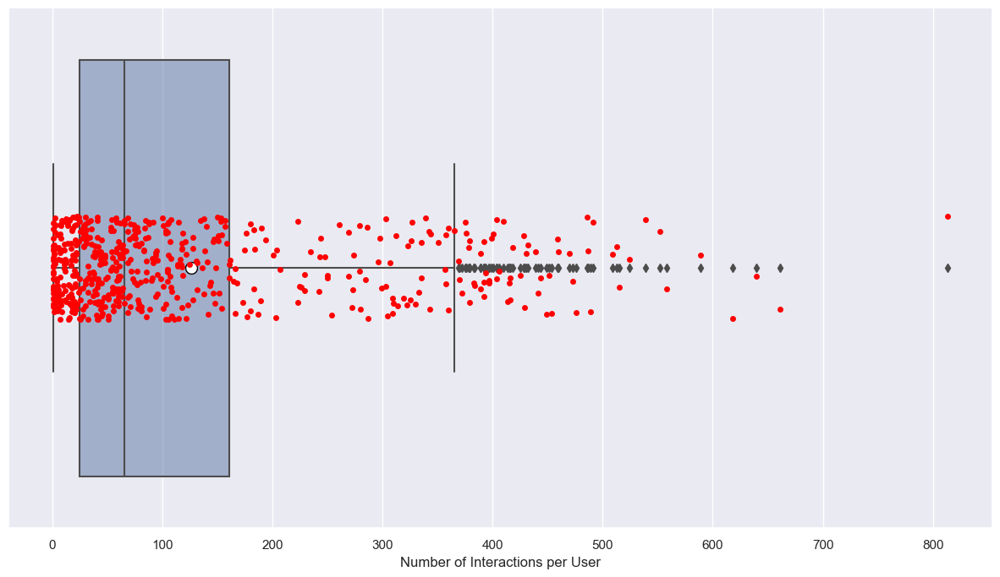

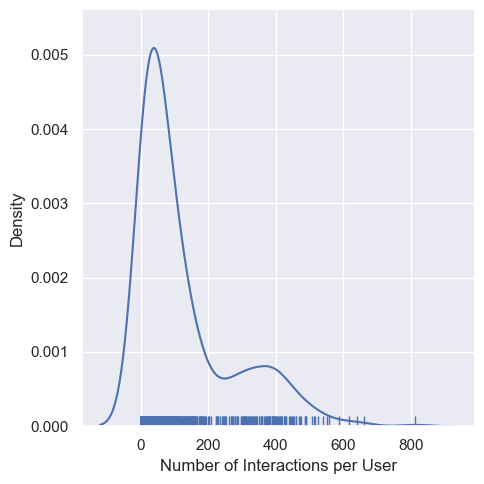

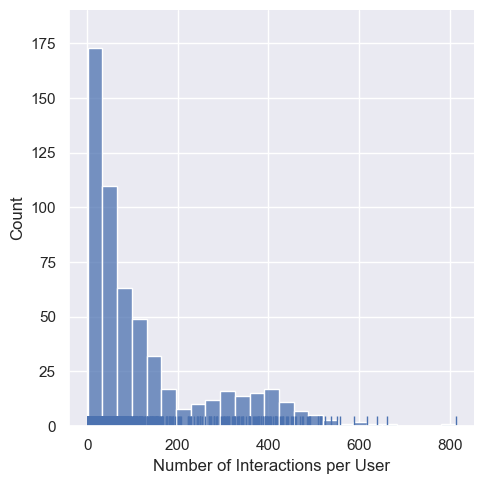

****************************************************************************************************
****************************************************************************************************
----------------------------------------------------------------------------------------------------
Number of Unique Topics per User:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Topics per User: 27.197183098591548
median: Number of Unique Topics per User: 16.0
max: Number of Unique Topics per User: 126
min: Number of Unique Topics per User: 1
std: Number of Unique Topics per User: 28.446239882973014
iqr: Number of Unique Topics per User: 29.0


Plots:


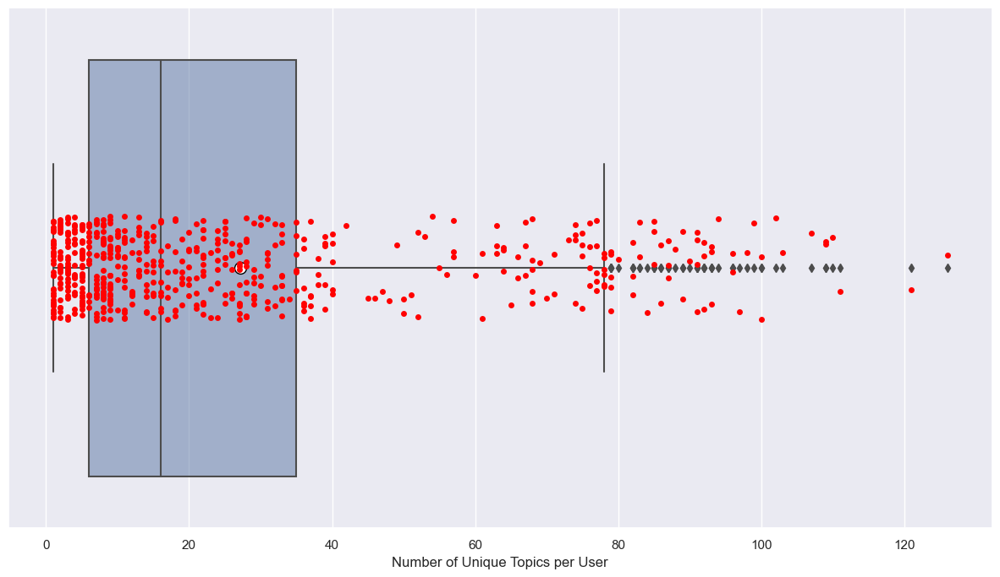

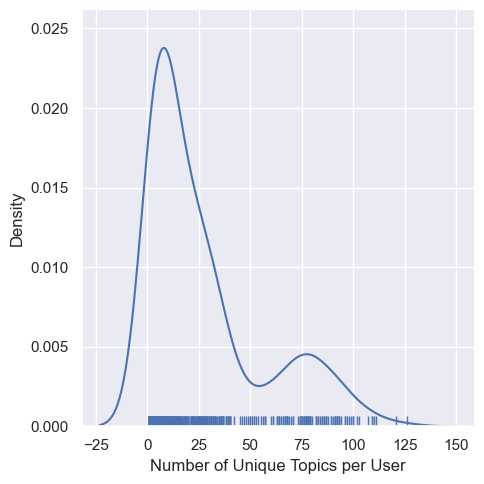

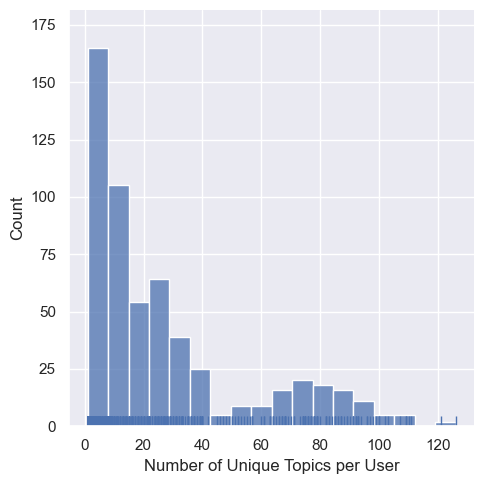

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Unique Learning Resources per User:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Learning Resources per User: 91.07922535211267
median: Number of Unique Learning Resources per User: 48.0
max: Number of Unique Learning Resources per User: 568
min: Number of Unique Learning Resources per User: 1
std: Number of Unique Learning Resources per User: 103.03441519238764
iqr: Number of Unique Learning Resources per User: 94.0


Plots:


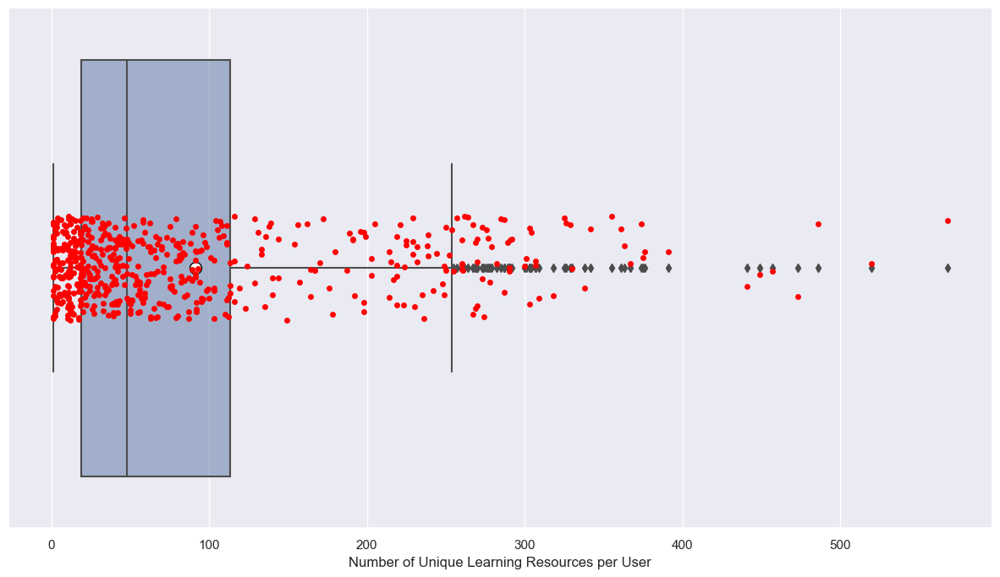

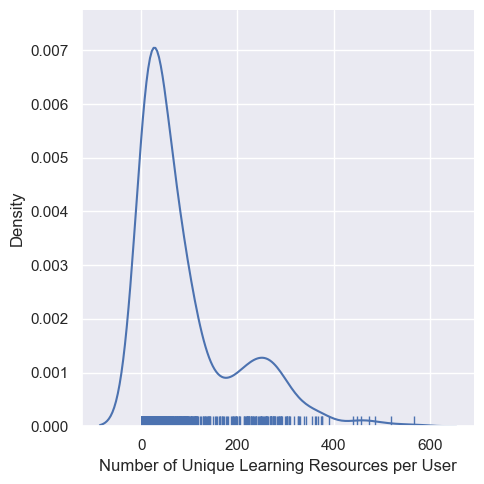

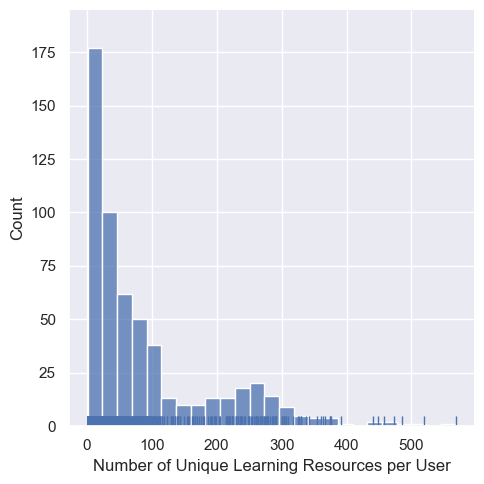

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Unique Users per Topic:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Users per Topic: 111.94202898550725
median: Number of Unique Users per Topic: 111.5
max: Number of Unique Users per Topic: 243
min: Number of Unique Users per Topic: 4
std: Number of Unique Users per Topic: 64.76648318967364
iqr: Number of Unique Users per Topic: 108.0


Plots:


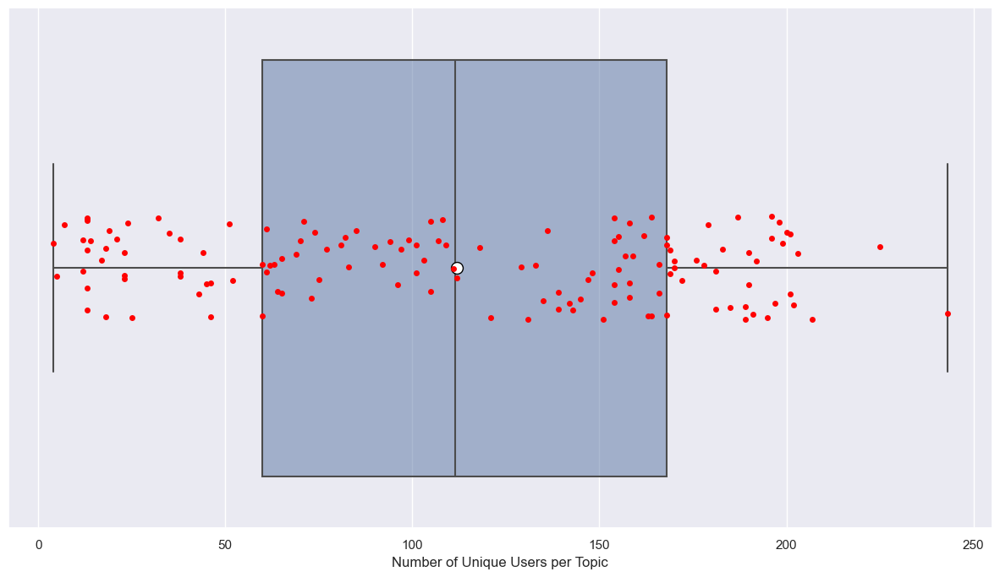

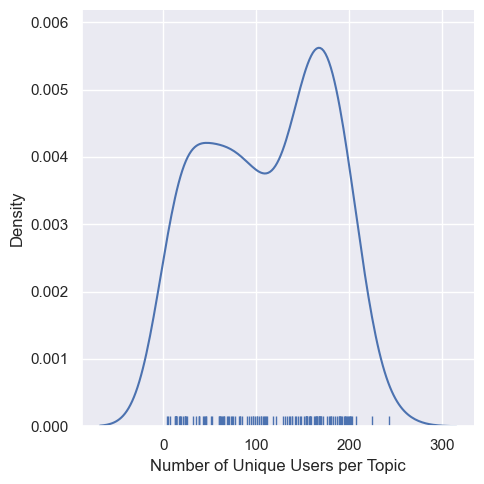

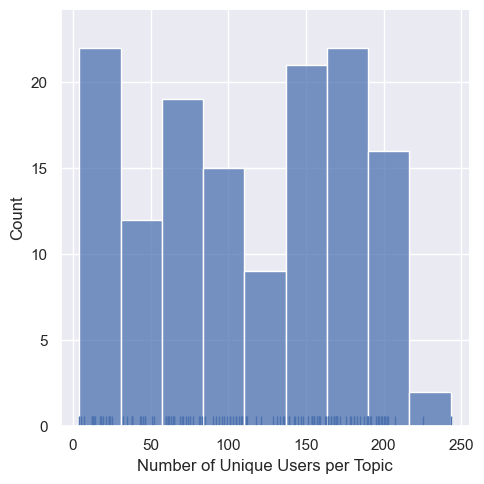

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Unique Learning Resources per Topic:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Learning Resources per Topic: 8.73913043478261
median: Number of Unique Learning Resources per Topic: 6.0
max: Number of Unique Learning Resources per Topic: 44
min: Number of Unique Learning Resources per Topic: 1
std: Number of Unique Learning Resources per Topic: 8.965712747894232
iqr: Number of Unique Learning Resources per Topic: 11.0


Plots:


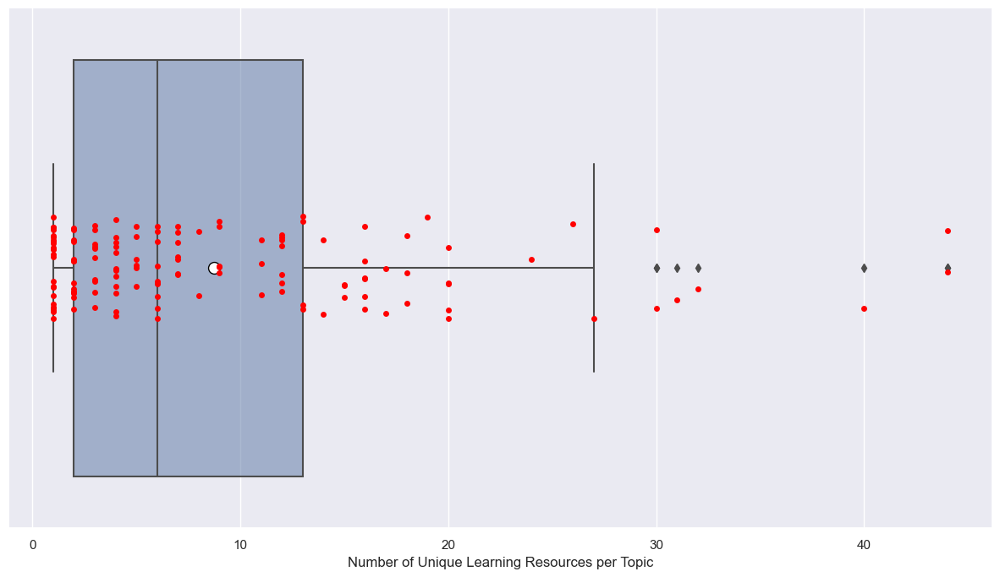

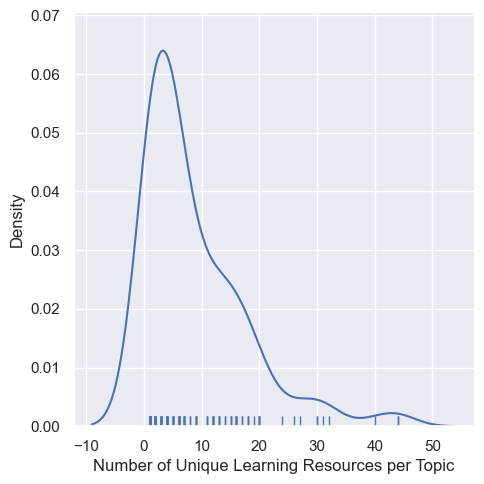

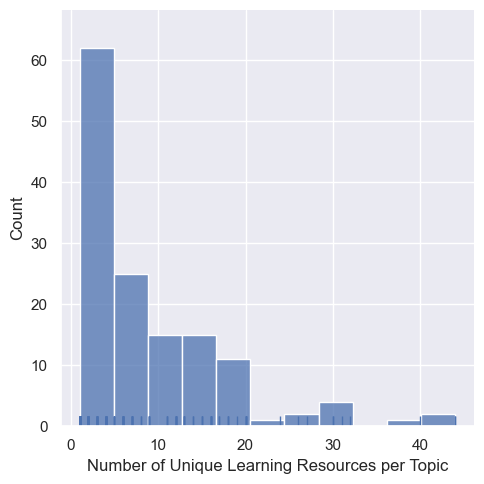

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Unique Users per Learning Resource:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Users per Learning Resource: 47.724169741697416
median: Number of Unique Users per Learning Resource: 27.0
max: Number of Unique Users per Learning Resource: 276
min: Number of Unique Users per Learning Resource: 1
std: Number of Unique Users per Learning Resource: 52.86244564445708
iqr: Number of Unique Users per Learning Resource: 54.0


Plots:


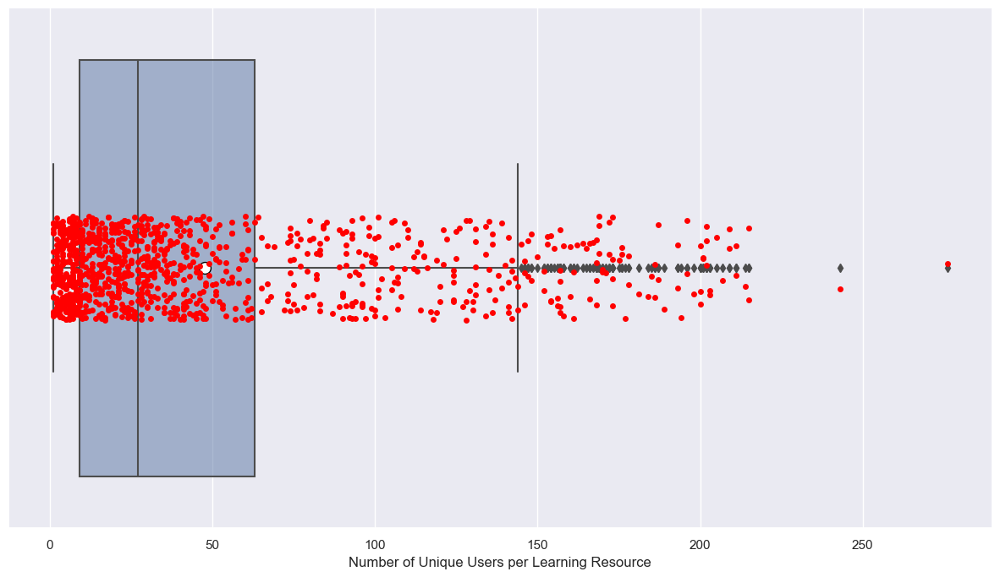

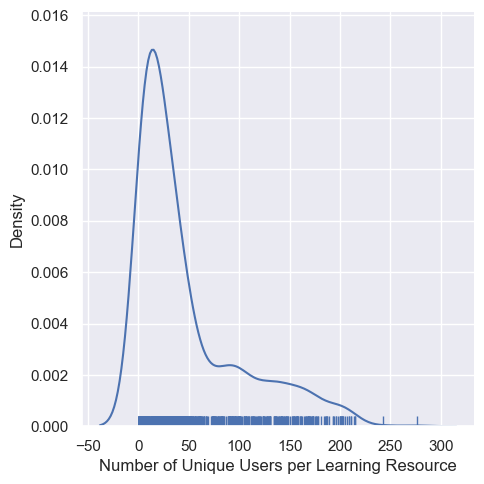

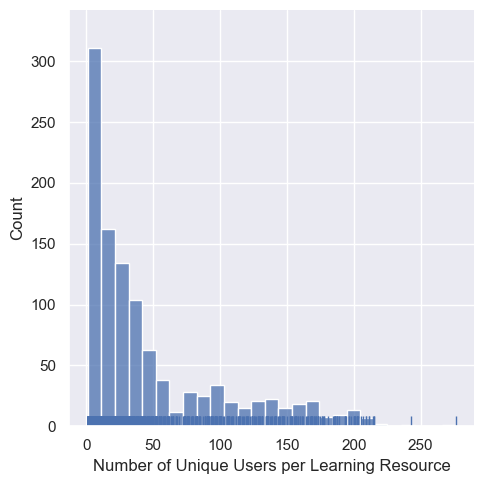

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Unique Topics per Learning Resource:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Topics per Learning Resource: 1.1125461254612545
median: Number of Unique Topics per Learning Resource: 1.0
max: Number of Unique Topics per Learning Resource: 4
min: Number of Unique Topics per Learning Resource: 1
std: Number of Unique Topics per Learning Resource: 0.3248259320679144
iqr: Number of Unique Topics per Learning Resource: 0.0


Plots:


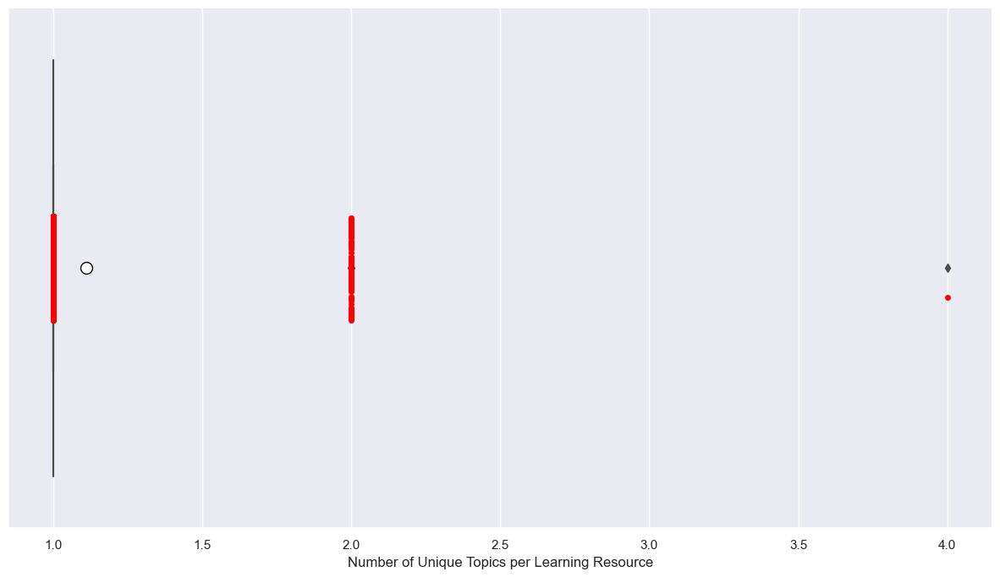

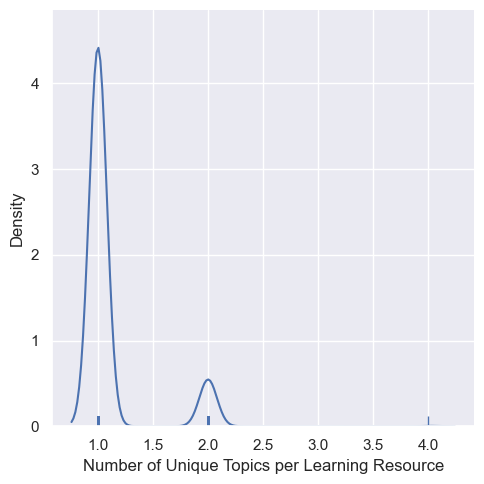

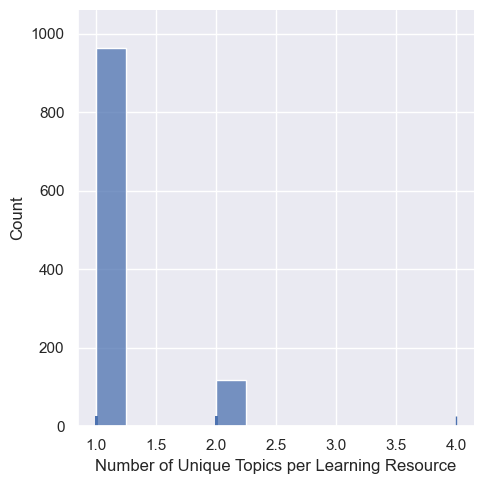

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Mean/Median Number of Interactions per Topic for a User:
----------------------------------------------------------------------------------------------------
mean of Mean Number of Interactions per Topic for a User: 4.325950608644833
median of Mean Number of Interactions per Topic for a User: 4.351494934519398
max of Mean Number of Interactions per Topic for a User: 12.5
min of Mean Number of Interactions per Topic for a User: 1.0
std of Mean Number of Interactions per Topic for a User: 1.6443632595351245
iqr of Mean Number of Interactions per Topic for a User: 1.9009090909090909

____________________________________________________________________________________________________

mean 

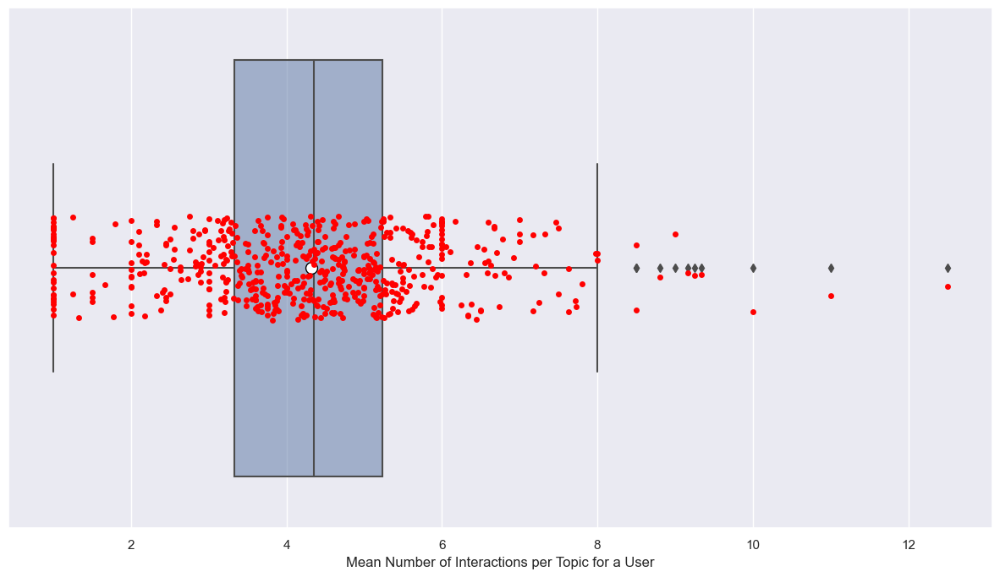

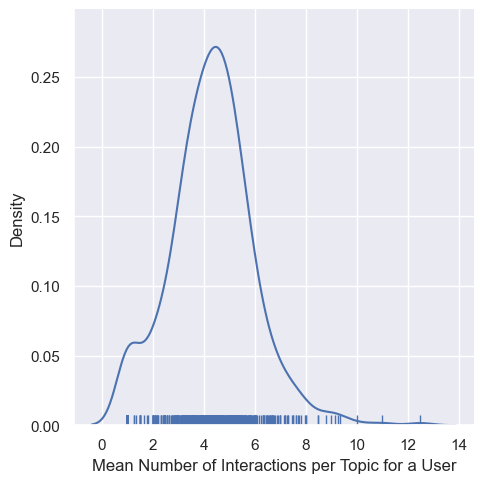

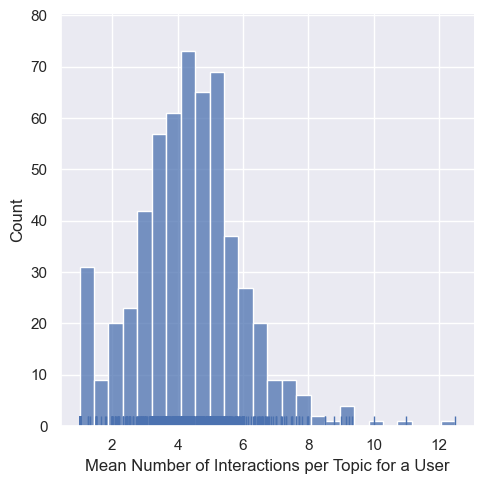



Median:


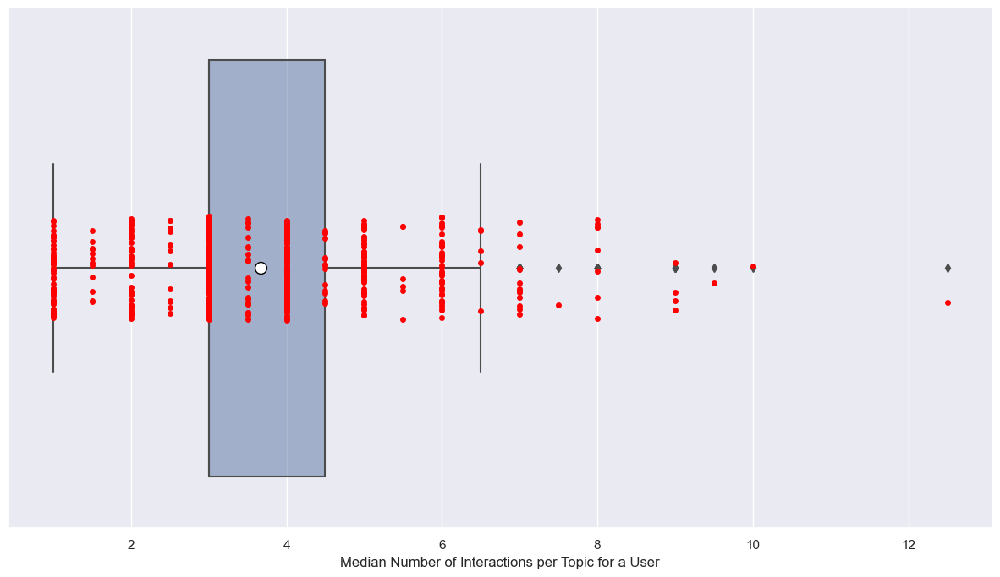

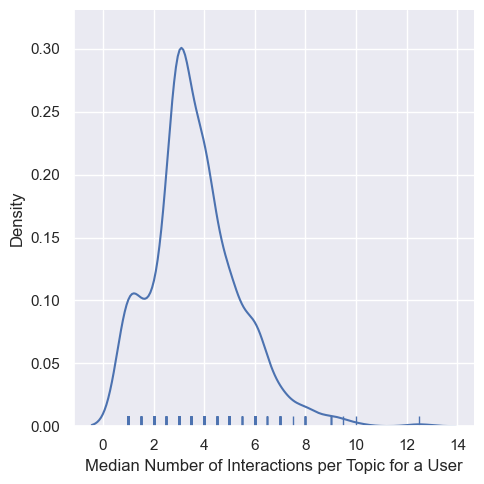

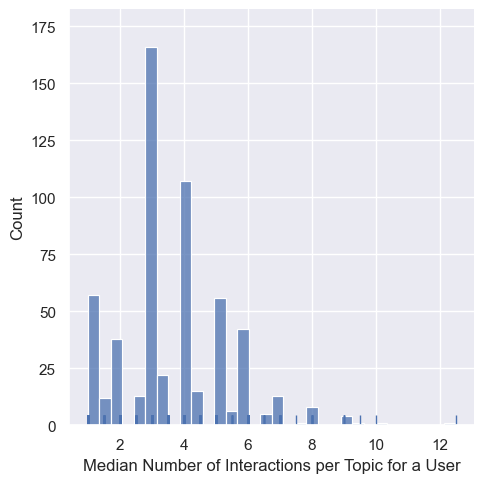

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Mean/Median Number of Interactions per User for a Topic:
----------------------------------------------------------------------------------------------------
mean of Mean Number of Interactions per User for a Topic: 5.219579824718523
median of Mean Number of Interactions per User for a Topic: 4.597418244406196
max of Mean Number of Interactions per User for a Topic: 23.857142857142858
min of Mean Number of Interactions per User for a Topic: 1.0
std of Mean Number of Interactions per User for a Topic: 3.906070603854954
iqr of Mean Number of Interactions per User for a Topic: 4.9111402263513515

______________________________________________________________________________________________

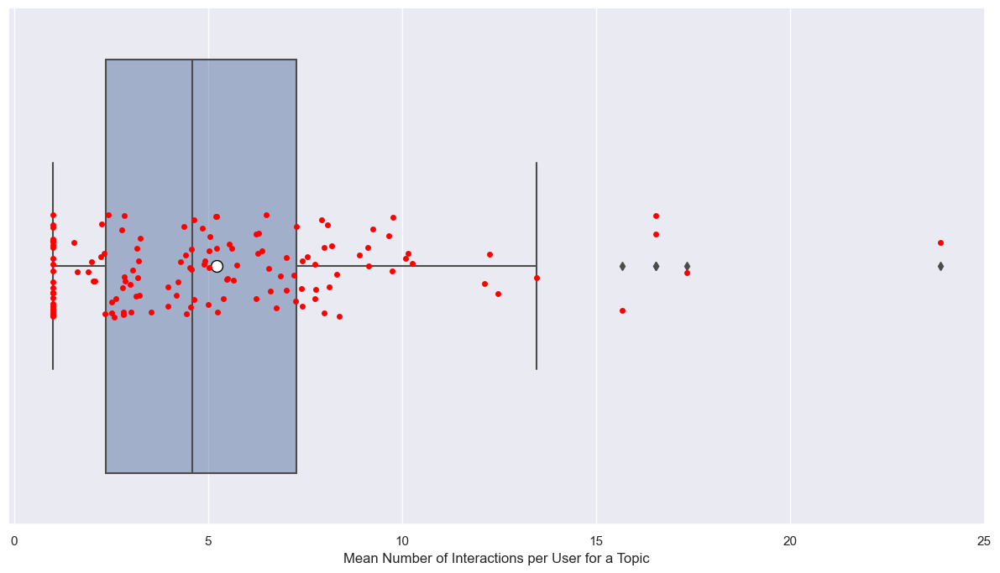

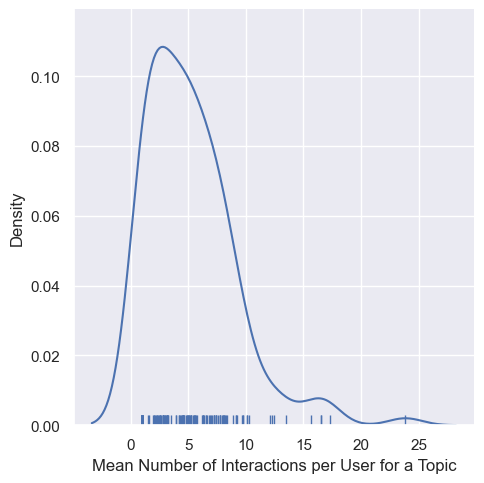

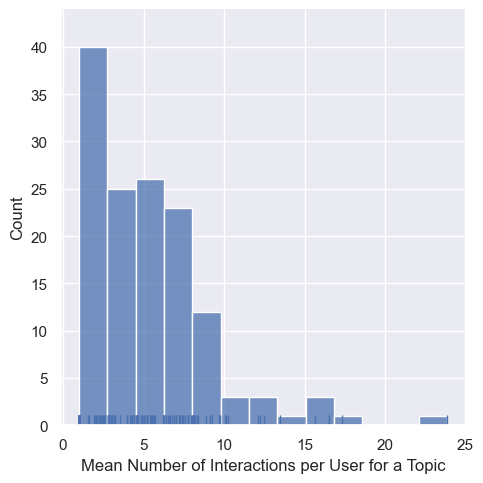



Median:


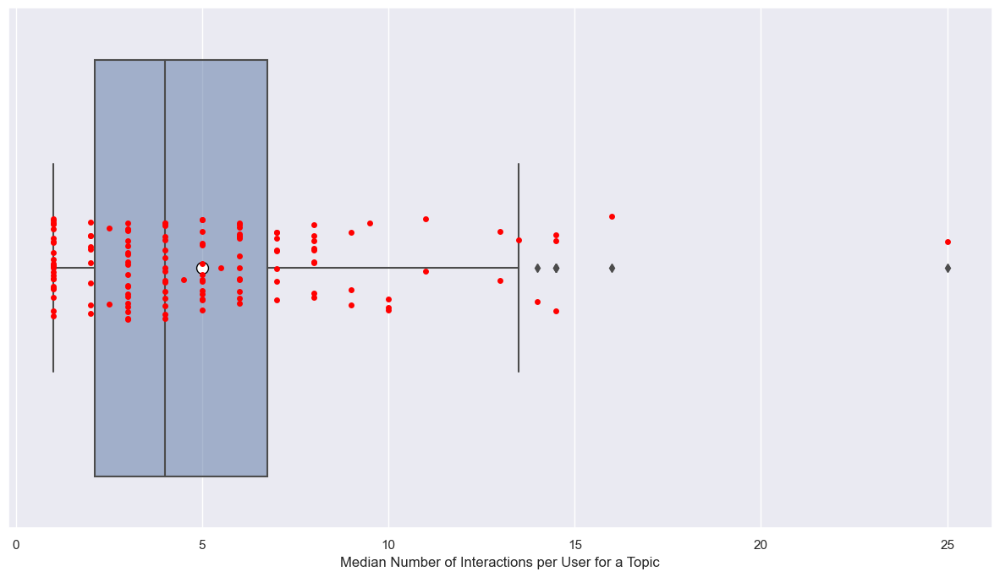

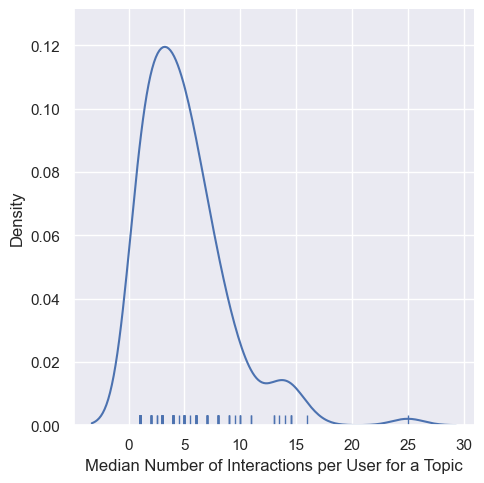

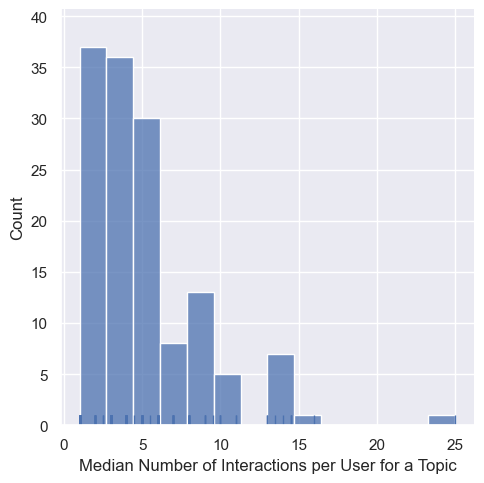

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Mean/Median Number of Unique Learning Resources per Topic for a User:
----------------------------------------------------------------------------------------------------
mean of Mean Number of Unique Learning Resources per Topic for a User: 3.616728905690798
median of Mean Number of Unique Learning Resources per Topic for a User: 3.6666666666666665
max of Mean Number of Unique Learning Resources per Topic for a User: 9.333333333333334
min of Mean Number of Unique Learning Resources per Topic for a User: 1.0

____________________________________________________________________________________________________

mean of Median Number of Unique Learning Resources per Topic for a User: 2.966

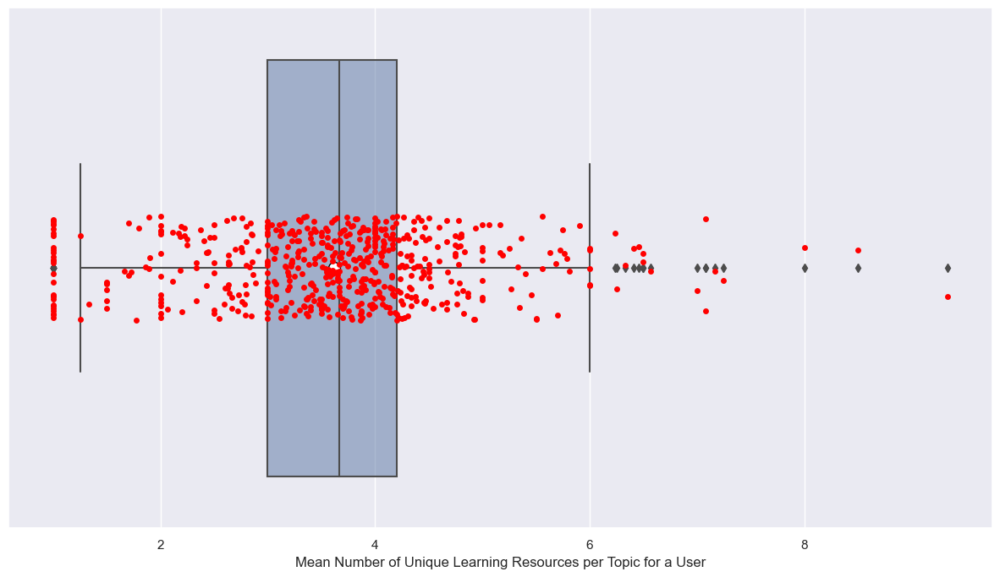

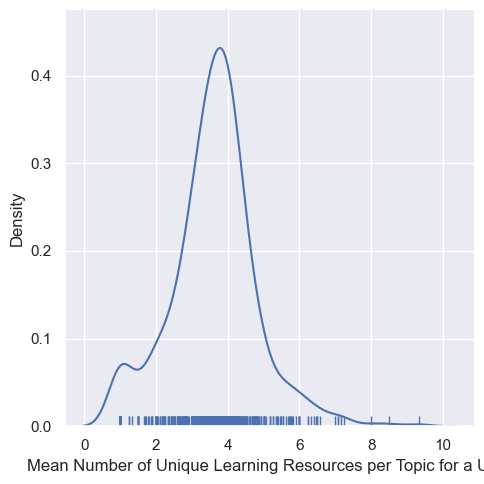

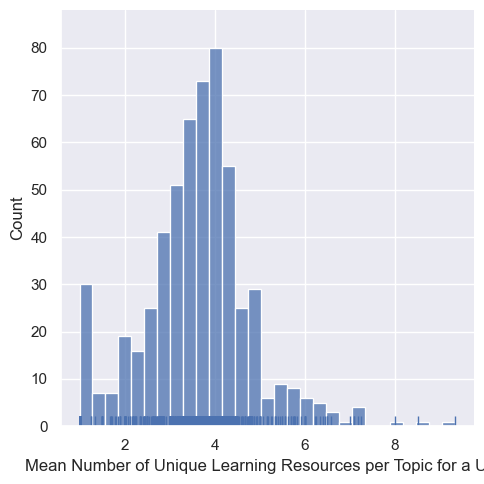



Median:


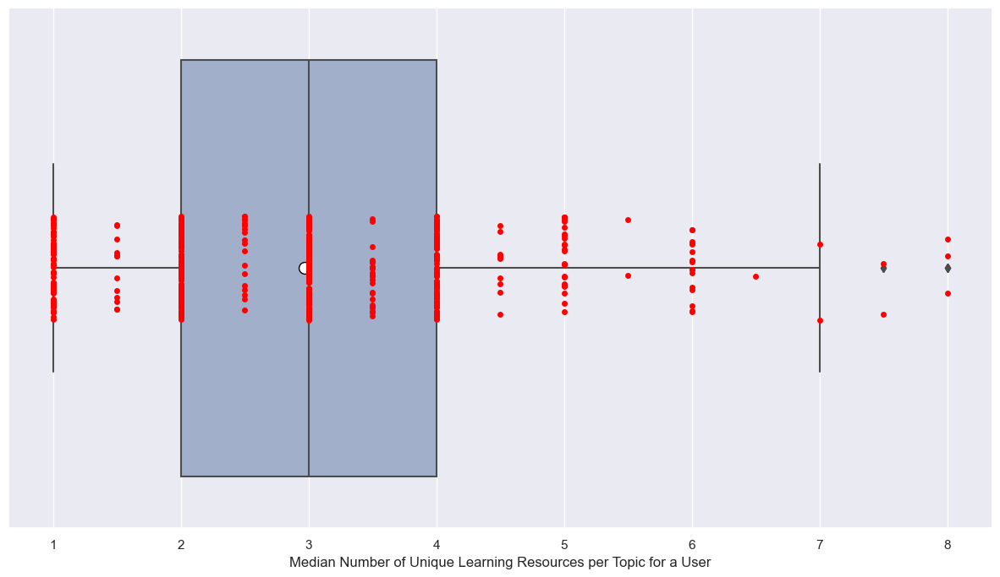

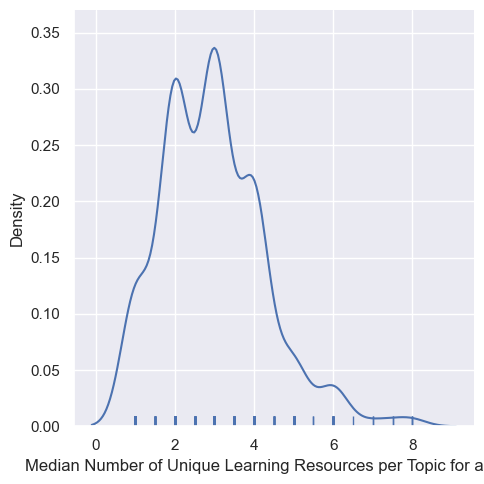

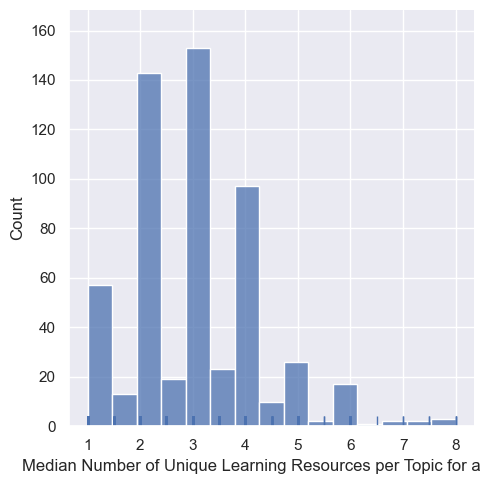

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Mean/Median Number of Unique Learning Resources per User for a Topic:
----------------------------------------------------------------------------------------------------
mean of Mean Number of Unique Learning Resources per User for a Topic: 4.418529144593096
median of Mean Number of Unique Learning Resources per User for a Topic: 3.9530083443126918
max of Mean Number of Unique Learning Resources per User for a Topic: 16.49411764705882
min of Mean Number of Unique Learning Resources per User for a Topic: 1.0

____________________________________________________________________________________________________

mean of Median Number of Unique Learning Resources per User for a Topic: 4.463

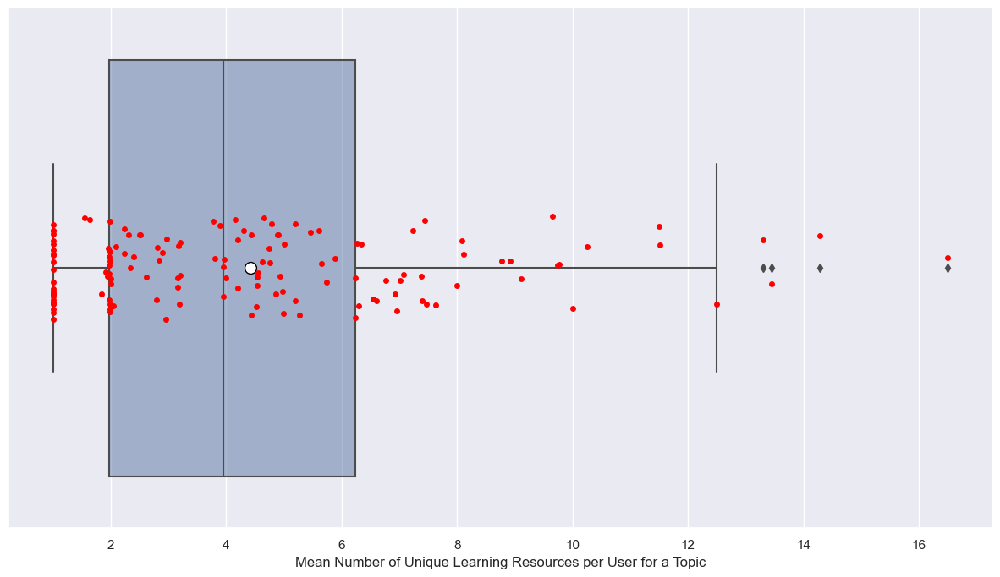

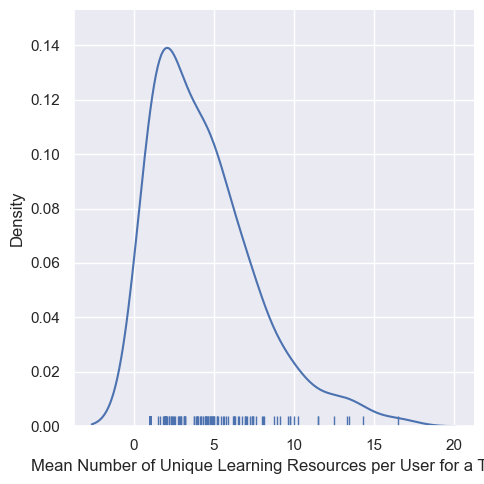

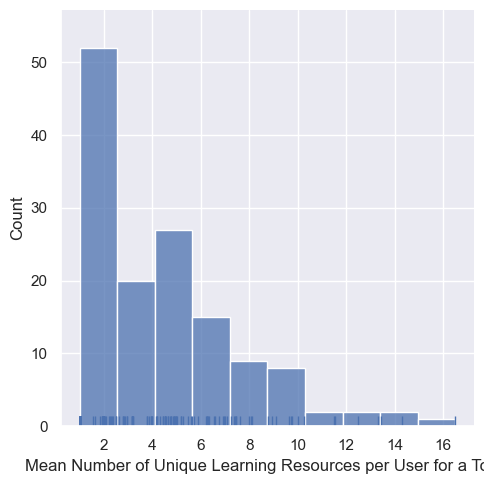



Median:


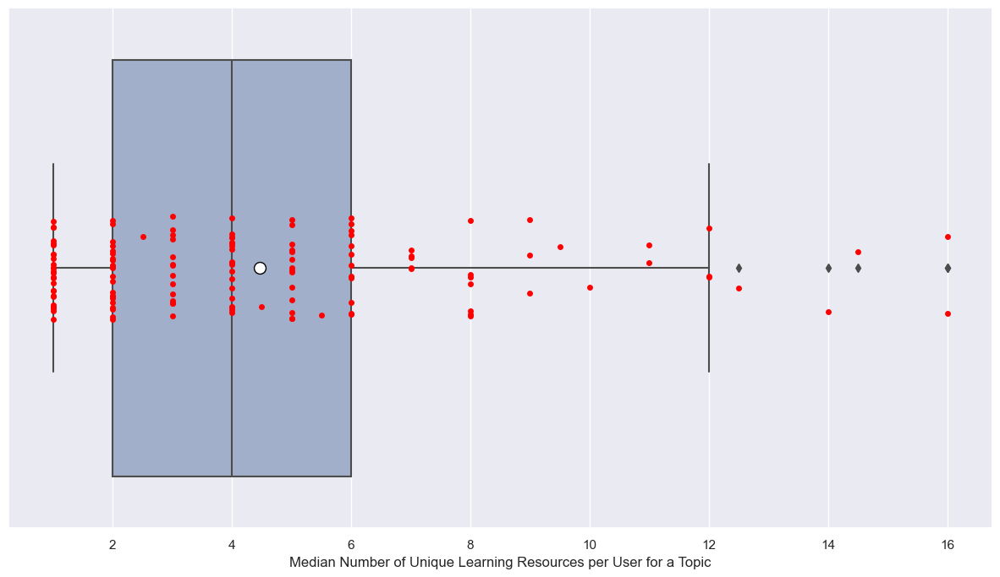

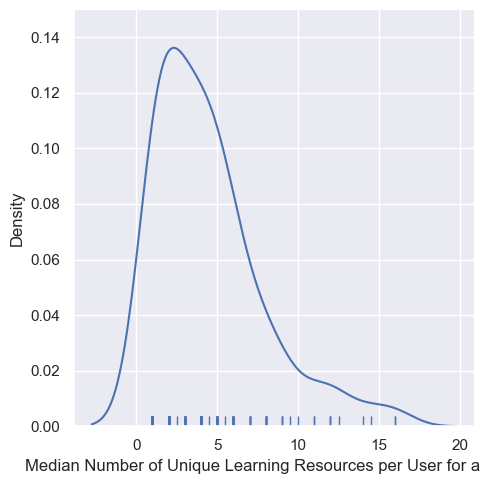

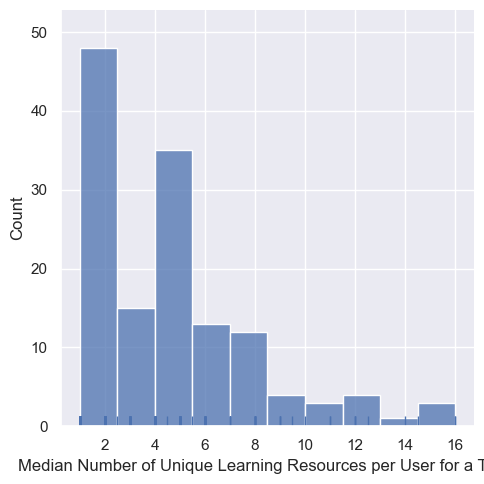

****************************************************************************************************
****************************************************************************************************
 


In [26]:
print_and_plot_group_user_learning_activity_relationship(interactions,
                                                         GROUP_FIELD_NAME_STR,
                                                         False)

## Unique Sequence Statistics

In [27]:
learning_activity_sequence_stats_per_group = return_learning_activity_sequence_stats_over_user_per_group(interactions,
                                                                                                         DATASET_NAME,
                                                                                                         GROUP_FIELD_NAME_STR, 
                                                                                                         USER_FIELD_NAME_STR, 
                                                                                                         LEARNING_ACTIVITY_FIELD_NAME_STR,
                                                                                                         TIMESTAMP_FIELD_NAME_STR)

In [28]:
pickle_write(learning_activity_sequence_stats_per_group,
             PATH_TO_SEQUENCE_STATISTICS_PICKLE_FOLDER,
             DATASET_NAME + SEQUENCE_STATISTICS_TABLES_PICKLE_NAME)

### Unique Sequence Statistics

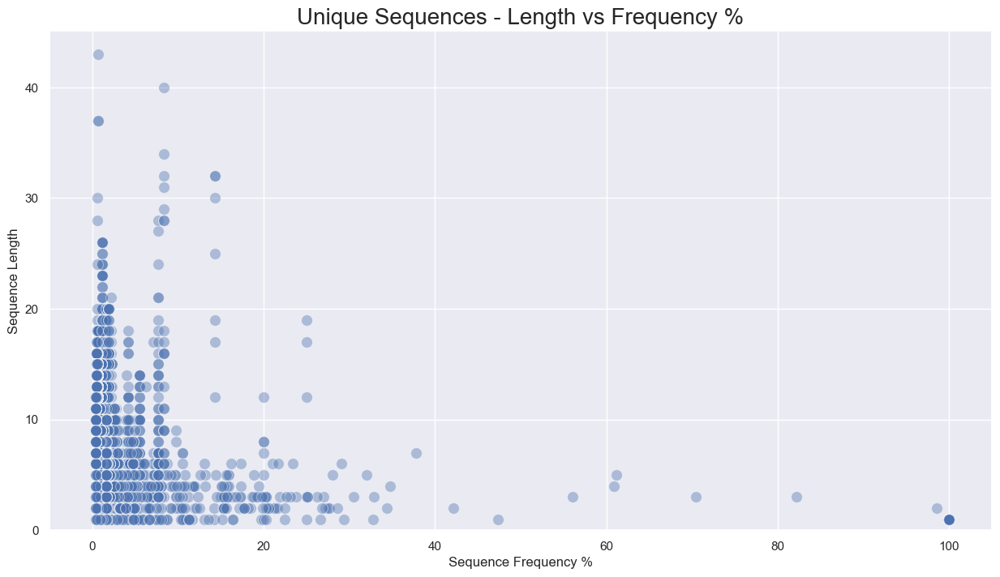

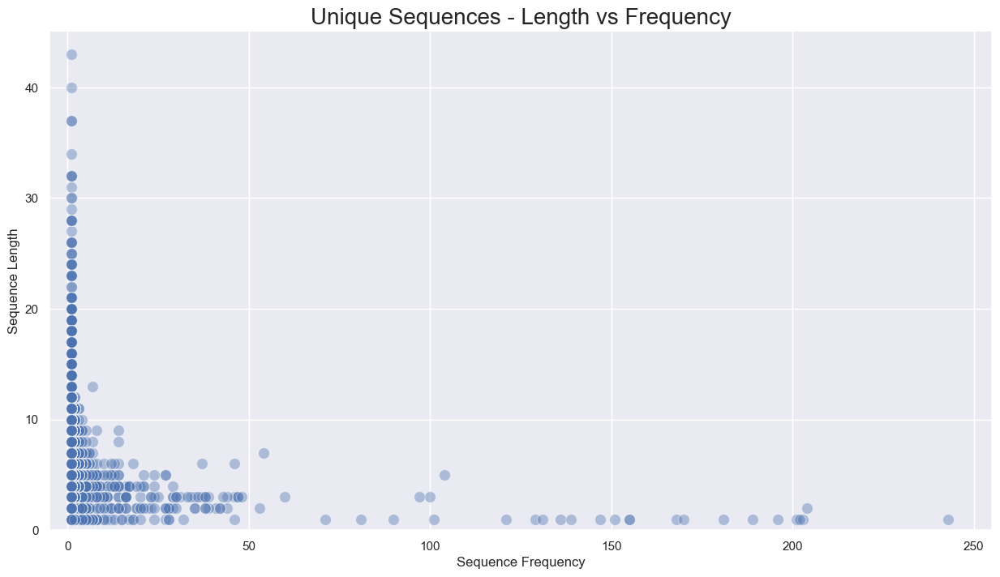

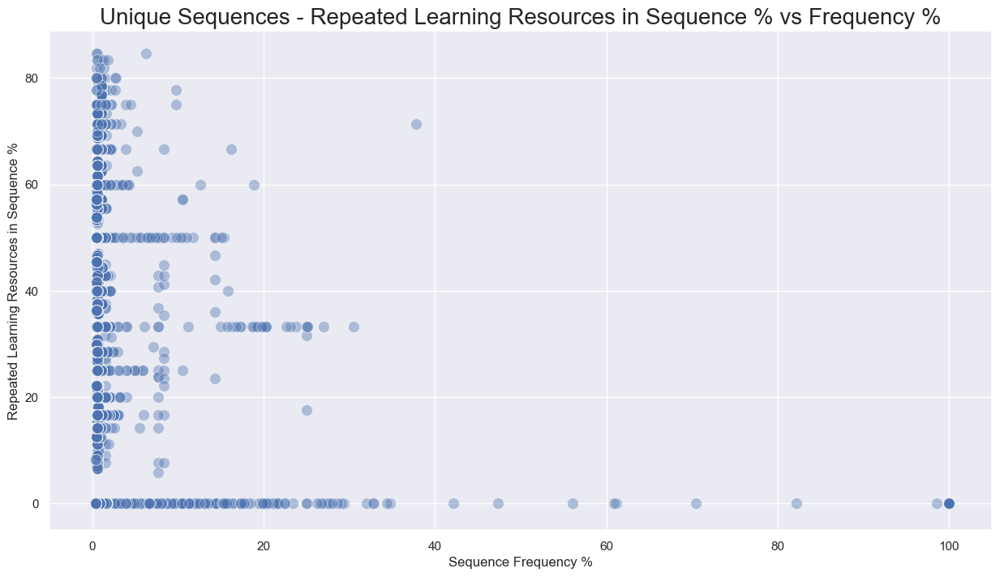

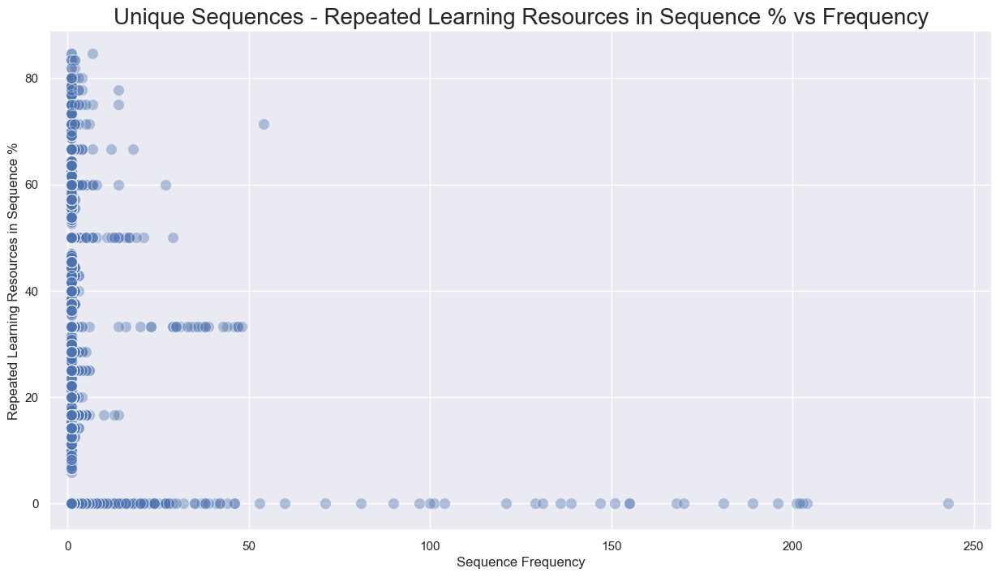

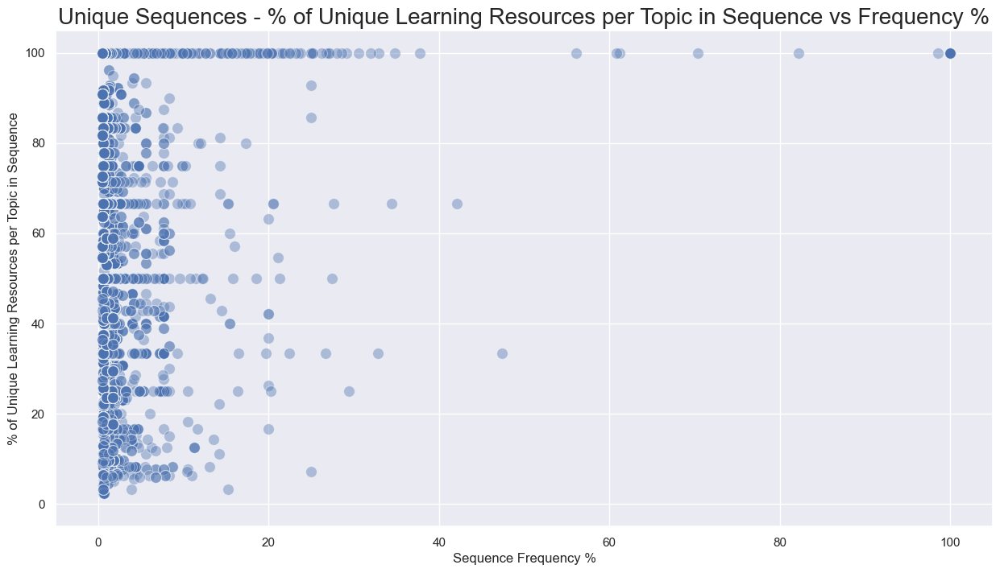

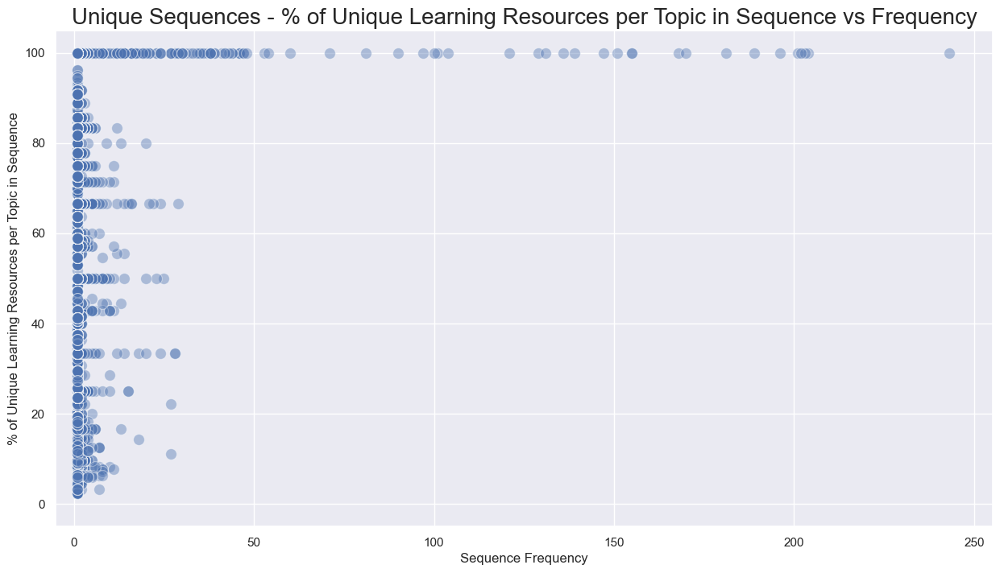

In [29]:
plot_sequence_stats(learning_activity_sequence_stats_per_group)

### Unique Sequence Statistics per Group

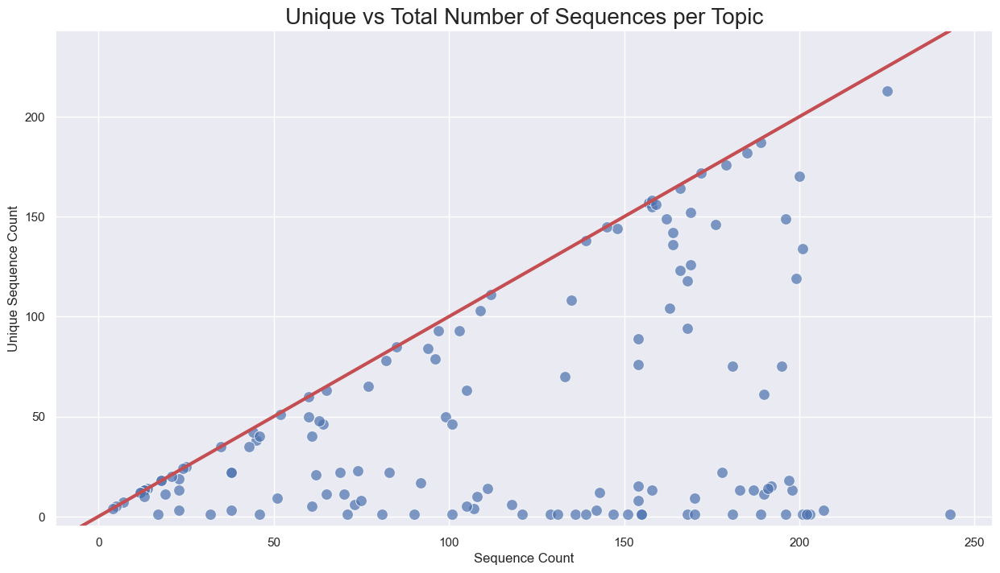

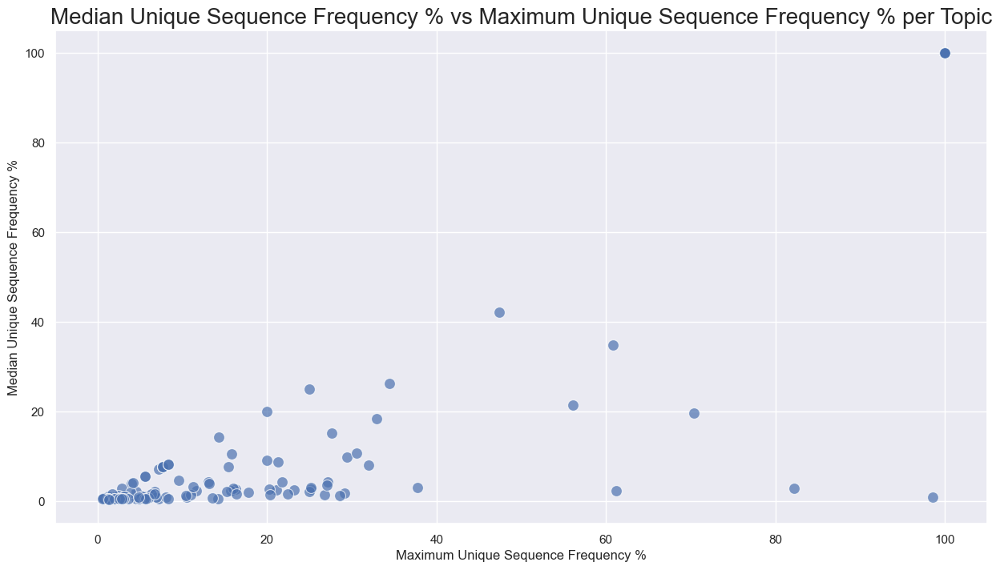

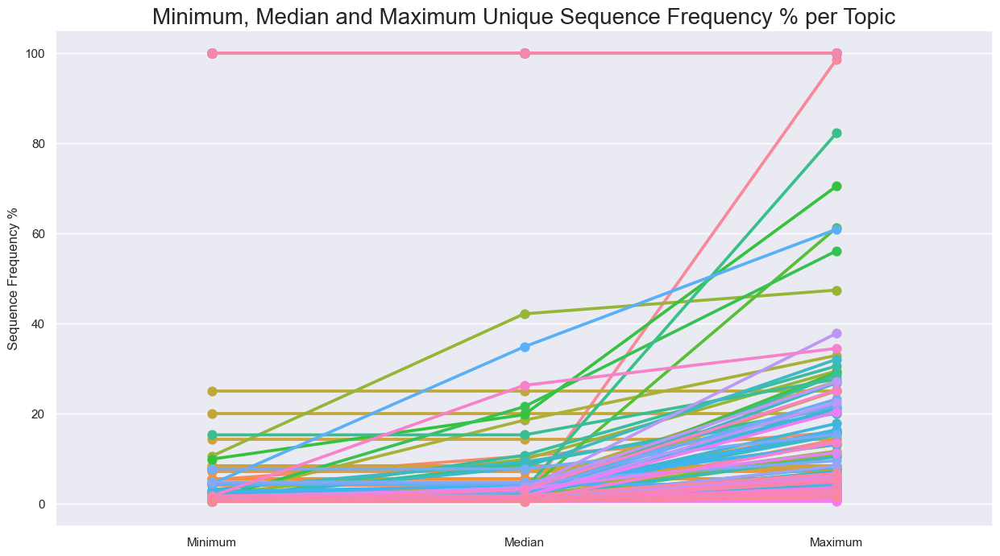

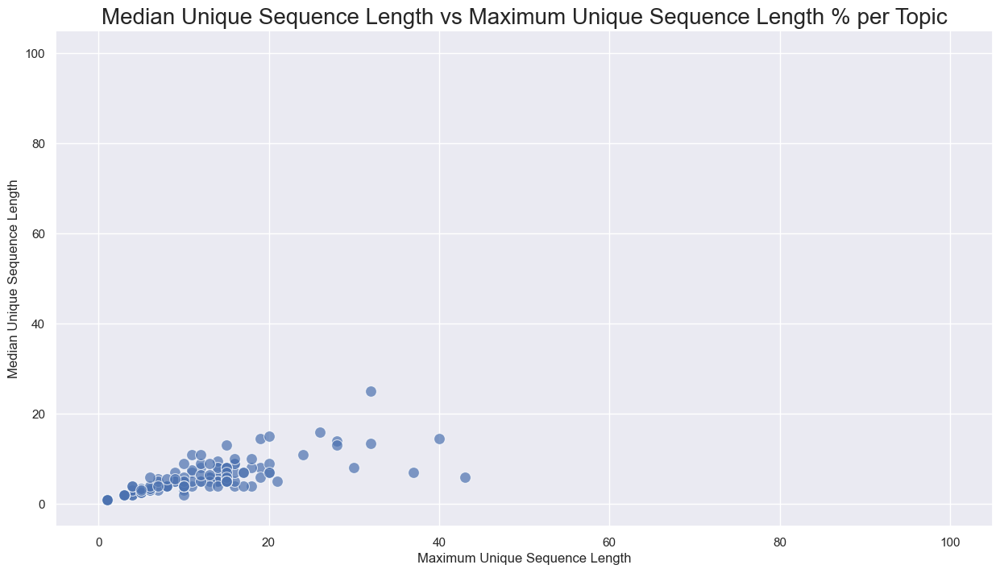

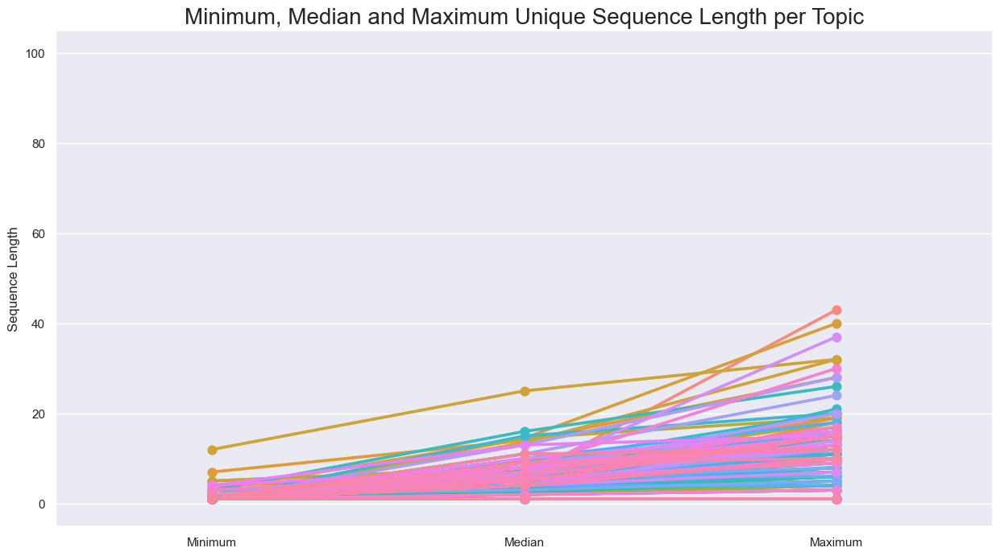

...

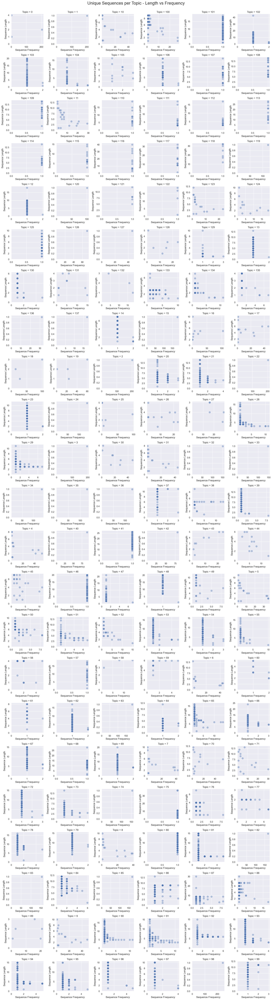

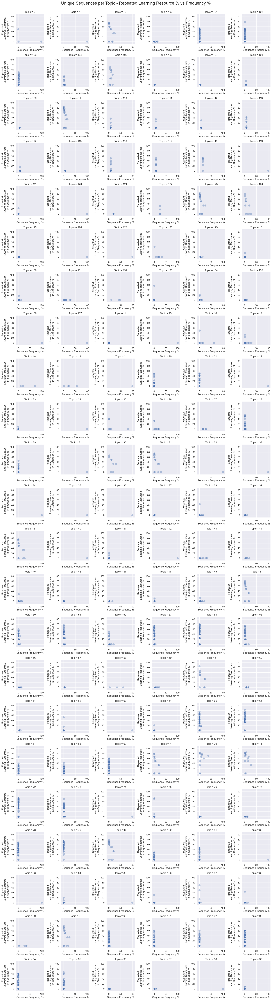

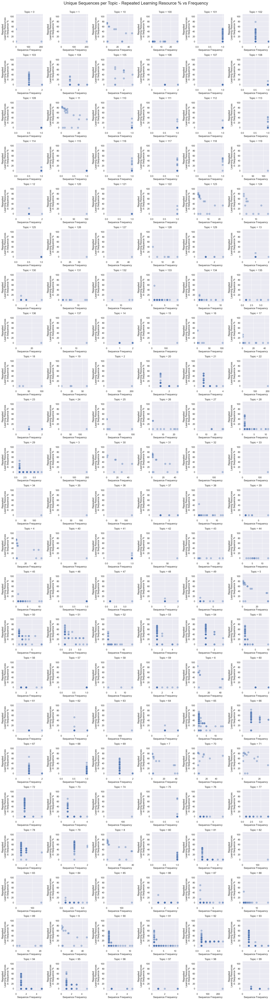

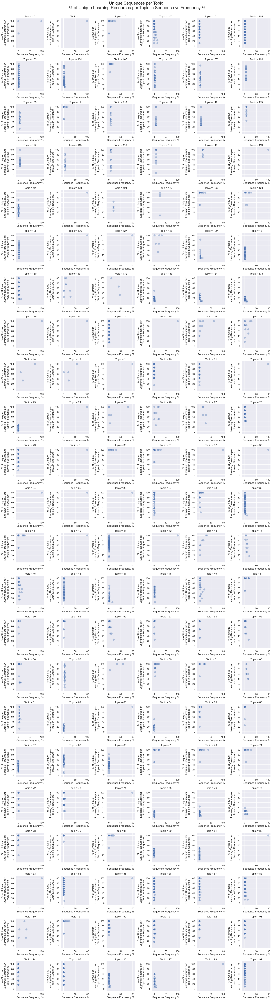

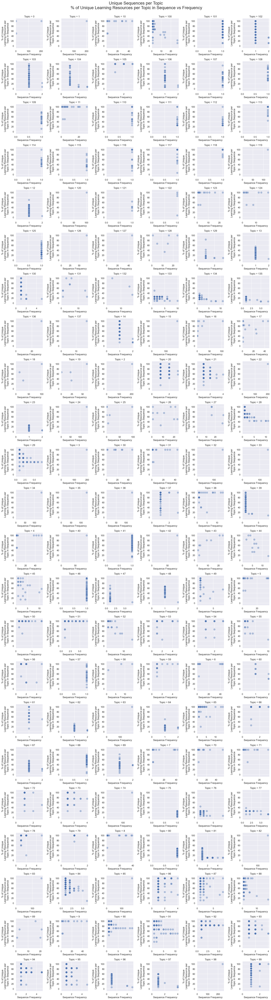

In [30]:
plot_sequence_stats_per_group(learning_activity_sequence_stats_per_group,
                              GROUP_FIELD_NAME_STR)

## Sequence Distance

In [31]:
seq_distances = calculate_sequence_distances(interactions, 
                                             USER_FIELD_NAME_STR, 
                                             GROUP_FIELD_NAME_STR, 
                                             LEARNING_ACTIVITY_FIELD_NAME_STR, 
                                             SEQUENCE_ID_FIELD_NAME_STR)

--------------------
Topic-Field Available:
Calulate Sequence Distances for each Topic
--------------------
--------------------------------------------------
Total number of Topic: 138
--------------------------------------------------
--------------------------------------------------
Final number of Topics: 138
Final number of Users: 568
Final number of interactions: 71972
--------------------------------------------------


100%|██████████| 138/138 [00:02<00:00, 61.49it/s]

--------------------------------------------------
Duration in seconds: 2.366421937942505
--------------------------------------------------


In [32]:
pickle_write(seq_distances,
             PATH_TO_SEQUENCE_DISTANCES_PICKLE_FOLDER,
             DATASET_NAME + SEQUENCE_DISTANCE_DICT_PER_GROUP_PICKLE_NAME)

100%|██████████| 138/138 [00:00<00:00, 1938.39it/s]


****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Sequence Distance per Topic:
Base: All User-Sequence Combinations
----------------------------------------------------------------------------------------------------


Plots:


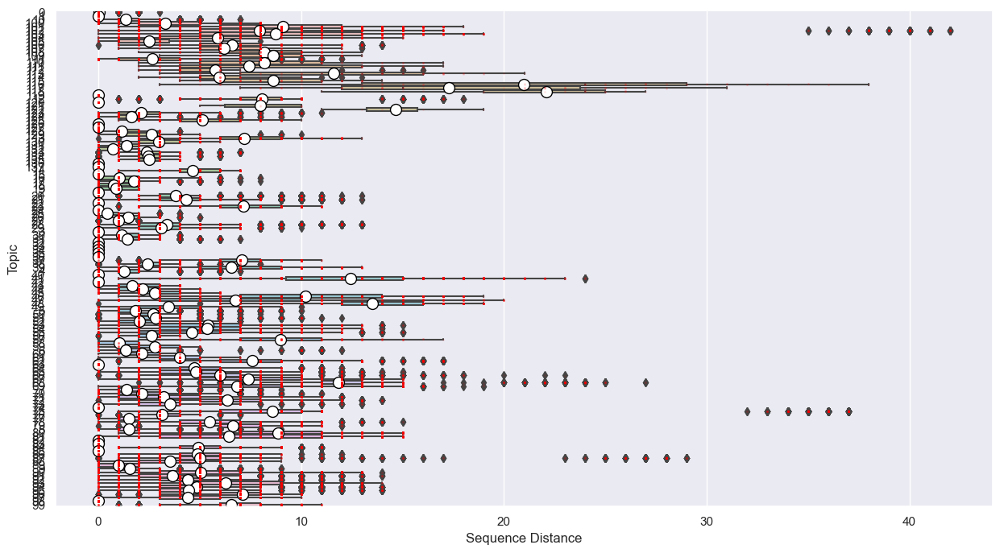

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Normalized Sequence Distance per Topic:
Base: All User-Sequence Combinations
----------------------------------------------------------------------------------------------------


Plots:


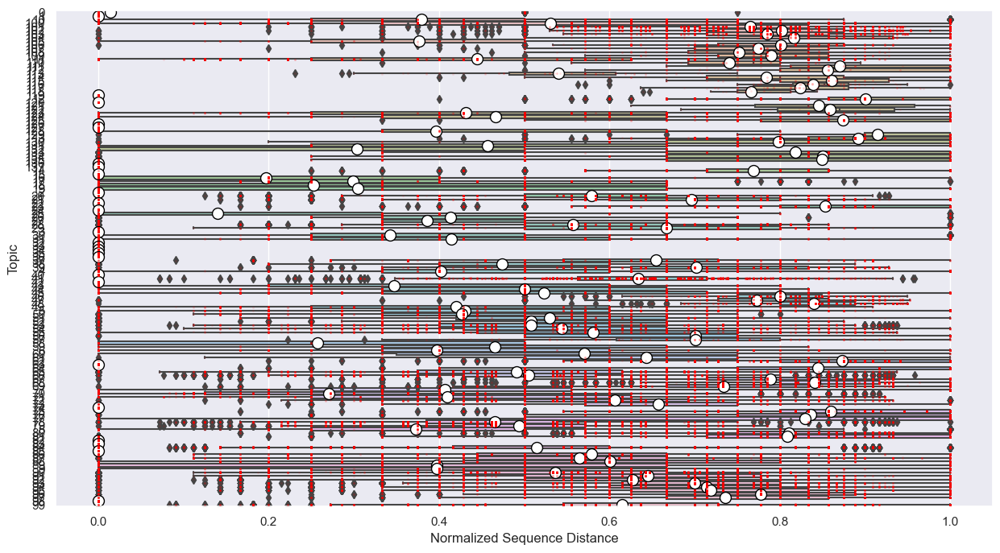

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Mean Sequence Distance per Topic:
----------------------------------------------------------------------------------------------------


Plots:


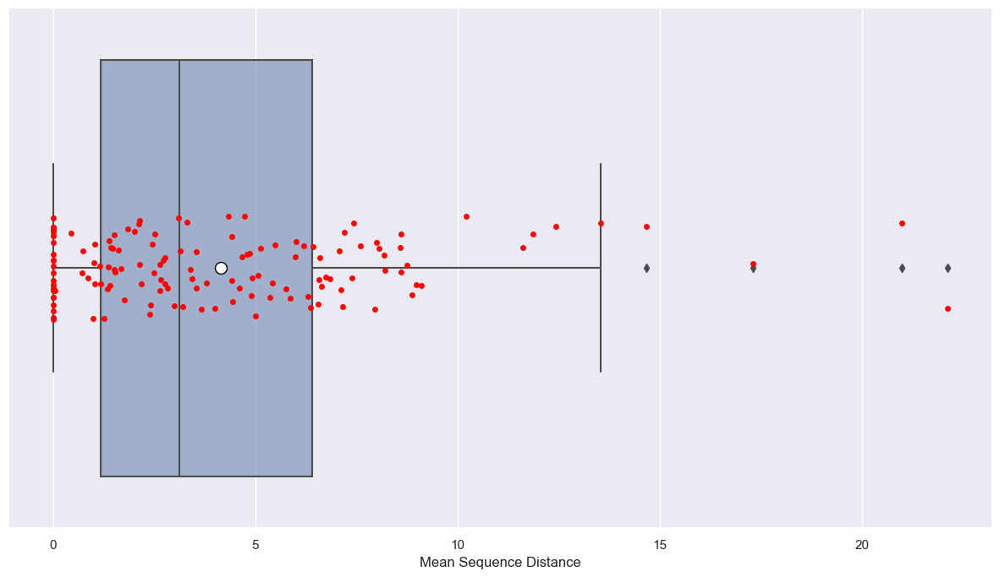

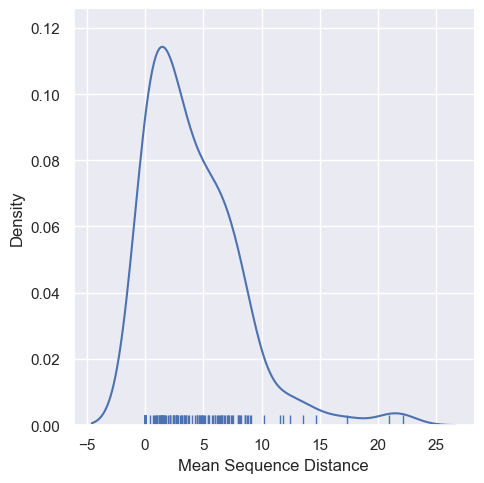

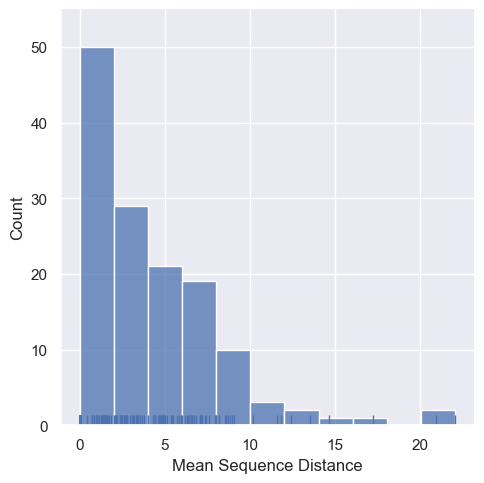

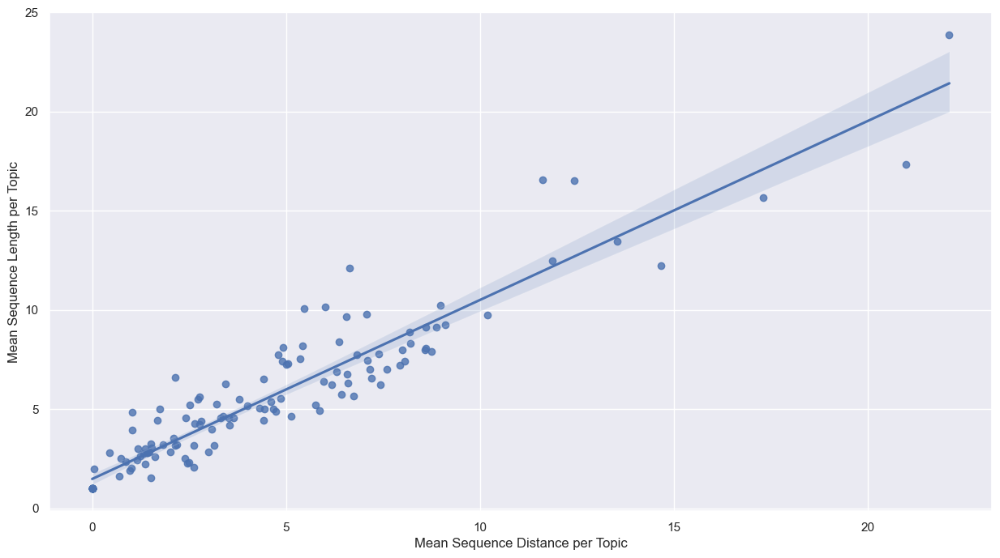

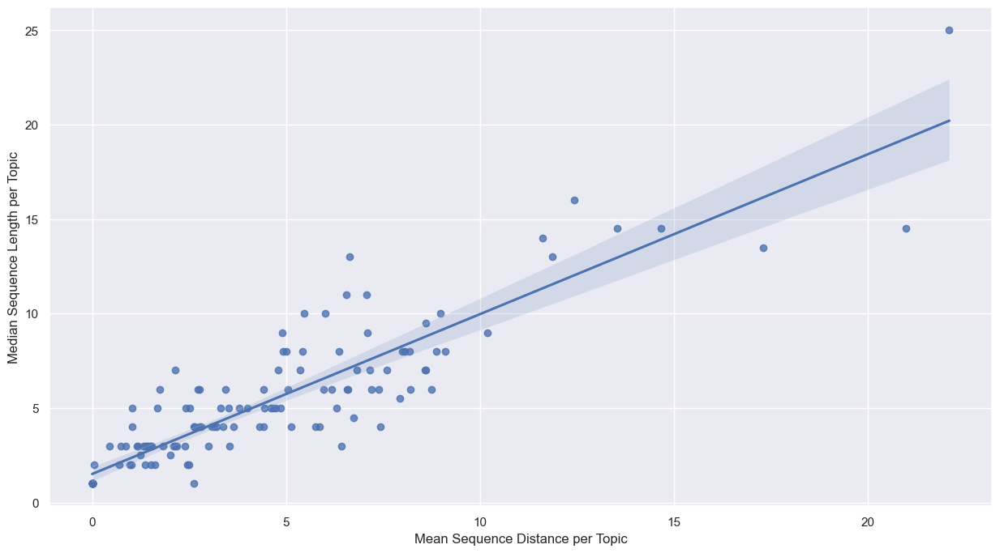

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Median Sequence Distance per Topic:
----------------------------------------------------------------------------------------------------


Plots:


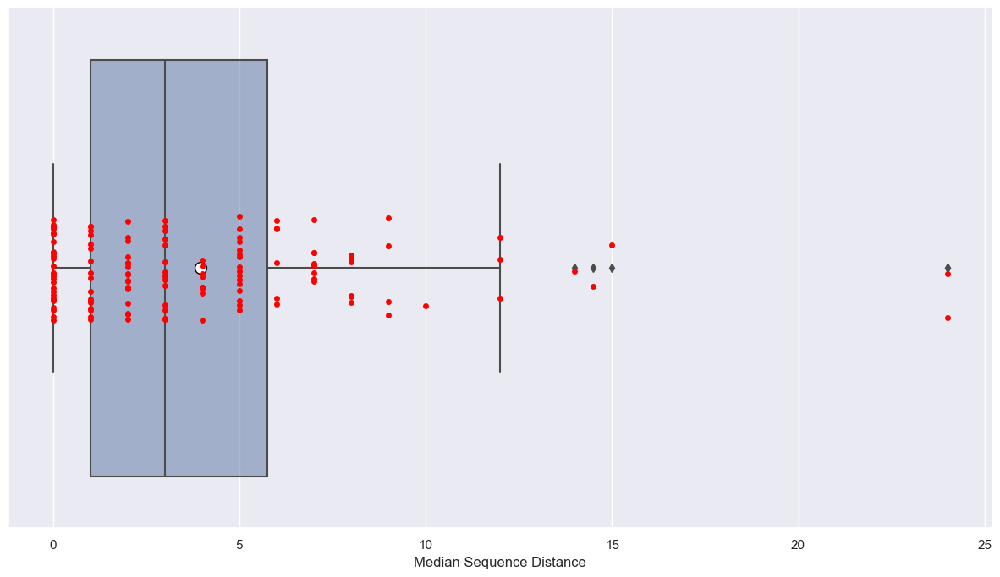

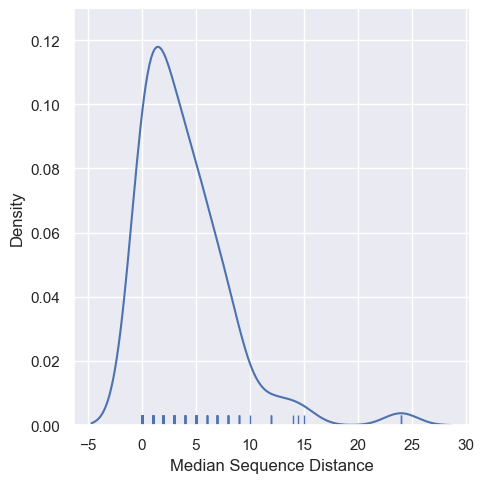

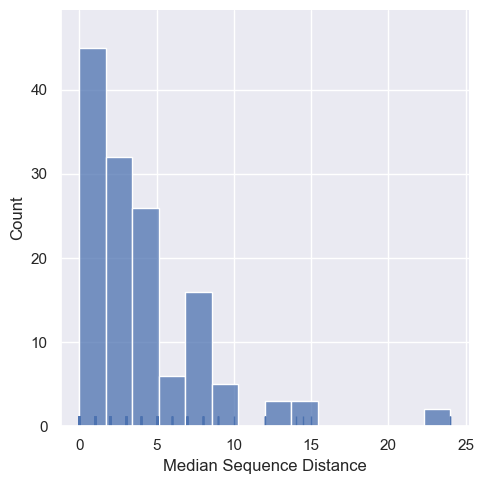

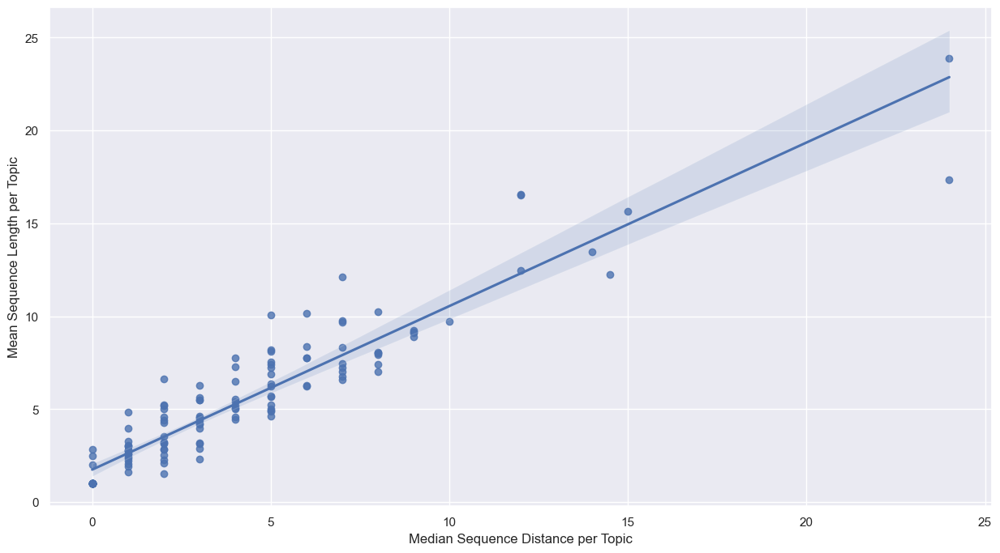

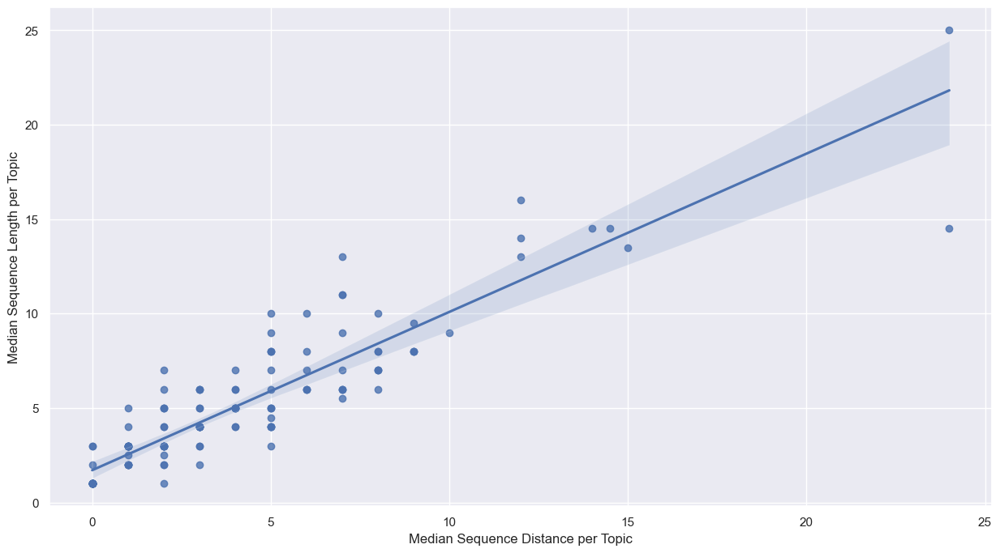

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Mean Normalized Sequence Distance per Topic:
----------------------------------------------------------------------------------------------------


Plots:


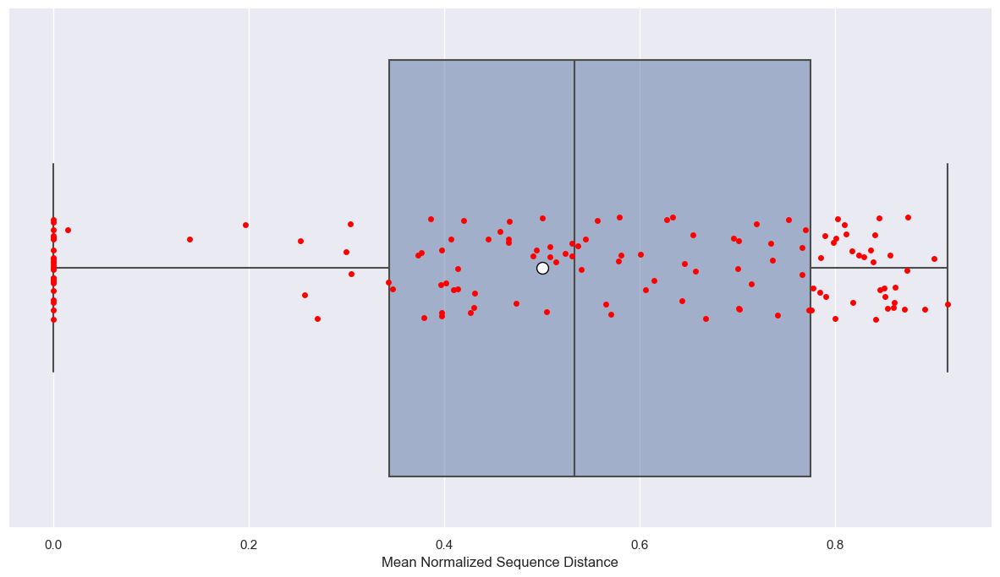

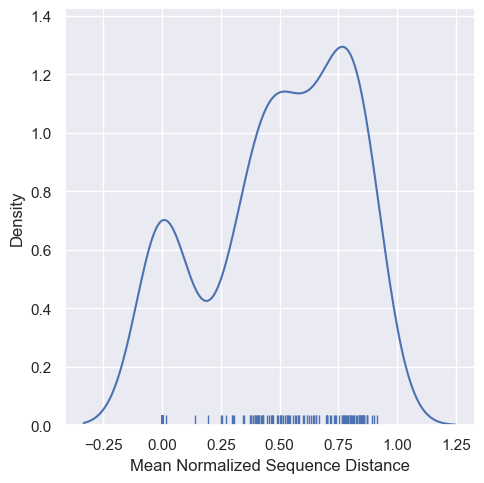

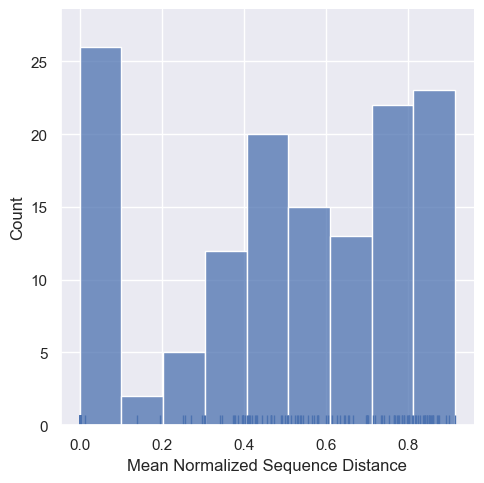

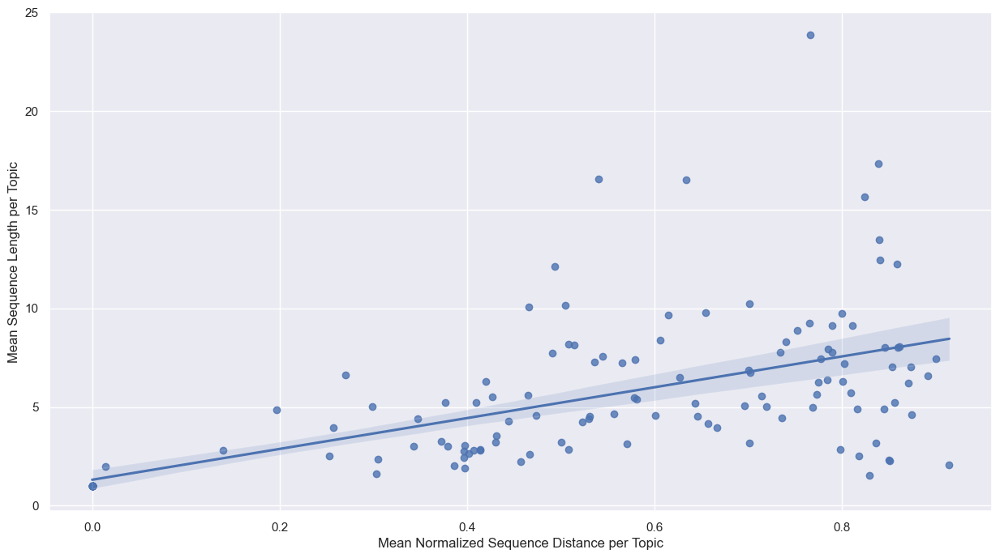

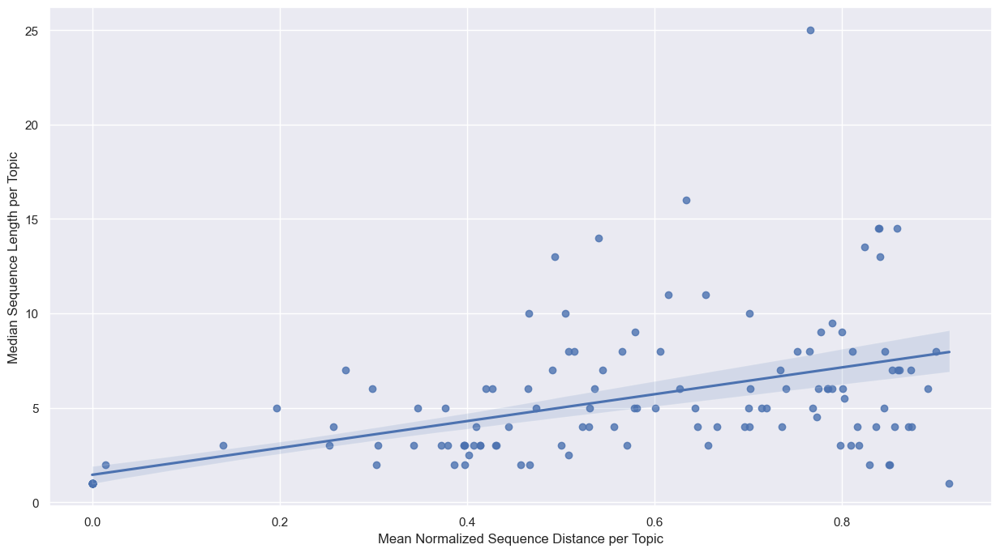

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Median Normalized Sequence Distance per Topic:
----------------------------------------------------------------------------------------------------


Plots:


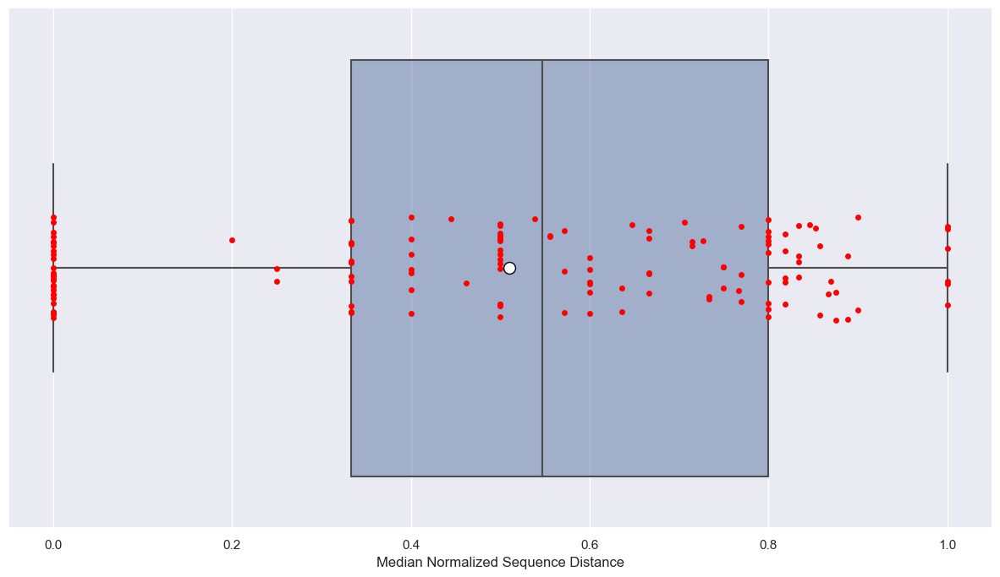

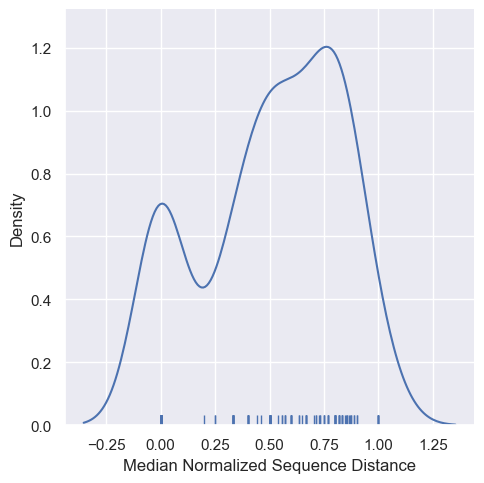

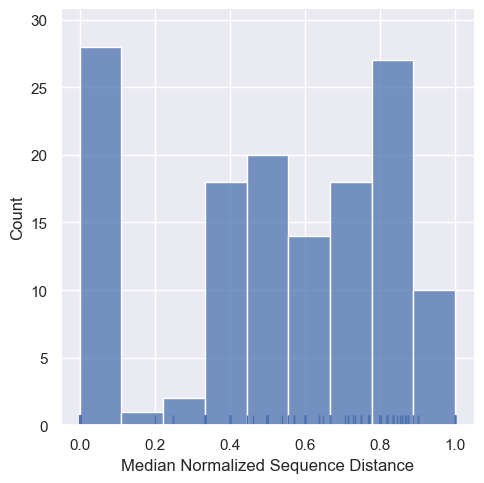

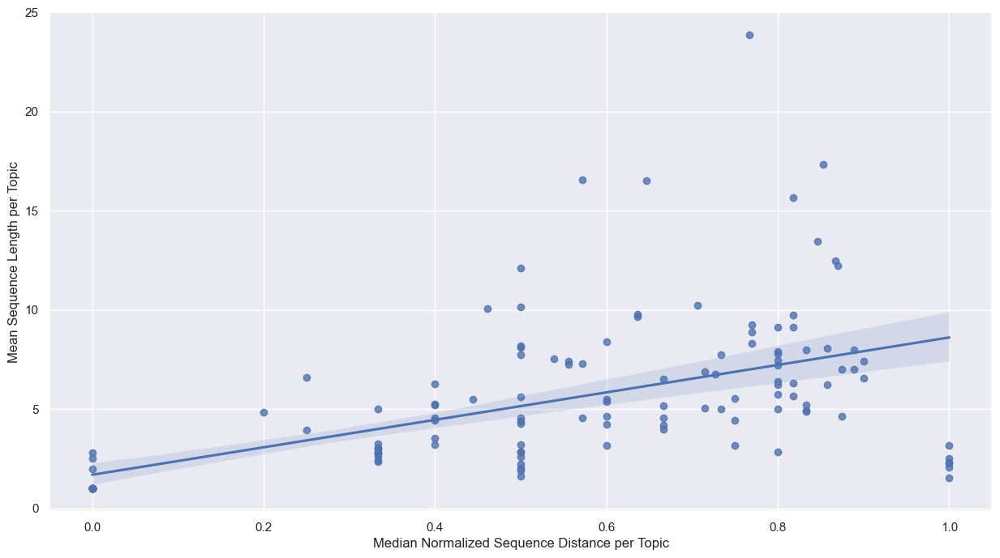

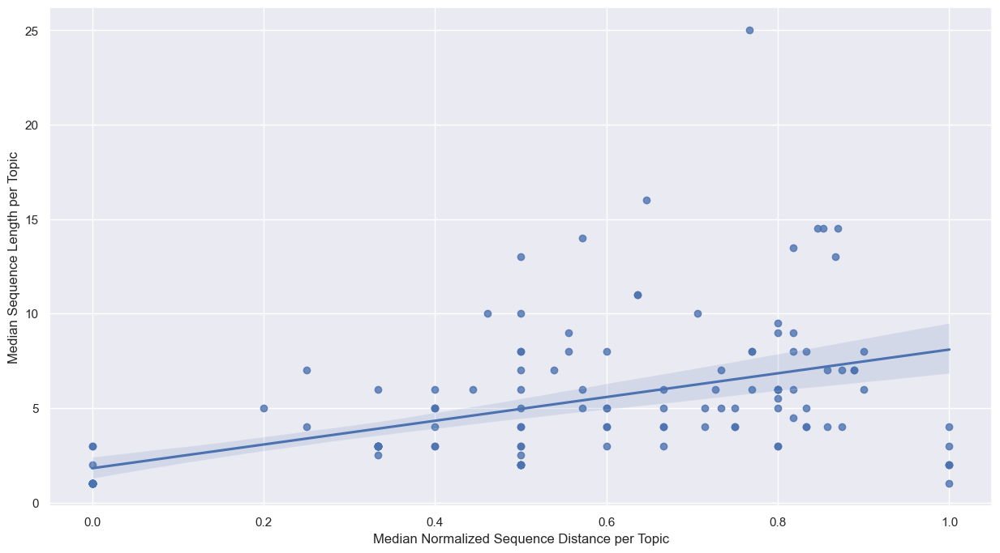

****************************************************************************************************
****************************************************************************************************
 


In [33]:
plot_sequence_distances(seq_distances)

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Sequence Distance Matrix per Topic:
----------------------------------------------------------------------------------------------------


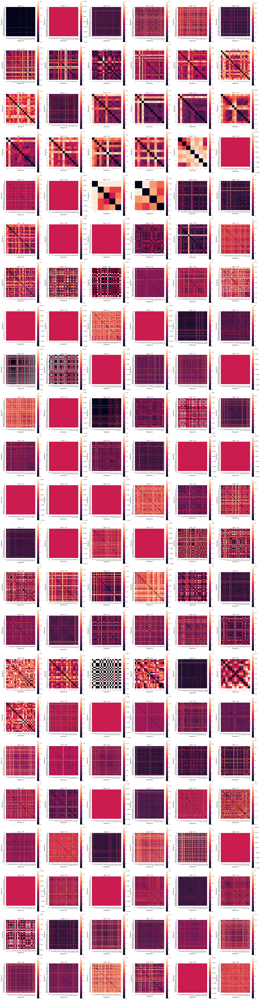

In [34]:
plot_sequence_distance_matrix_all_group(seq_distances,
                                        False,
                                        5)

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Normalized Sequence Distance Matrix per Topic:
----------------------------------------------------------------------------------------------------


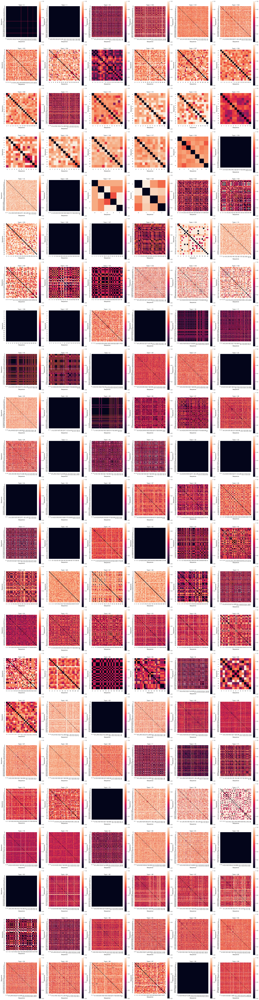

In [35]:
plot_sequence_distance_matrix_all_group(seq_distances,
                                        True,
                                        5)

## Clustering of Sequence Distances and Testing for Evaluation Metric Central Tendency Differences between Clusters 

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Cluster Analysis - Topic Selection Criteria
----------------------------------------------------------------------------------------------------
 
Unique vs Total Number of Sequences per Topic:


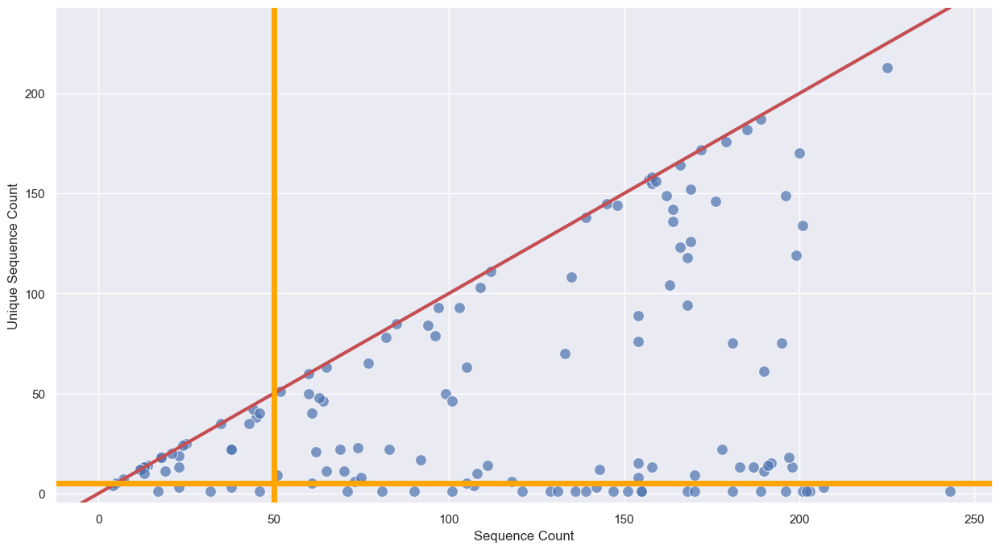

Normalized Sequence Distance per Topic:
Base: All User-Sequence Combinations


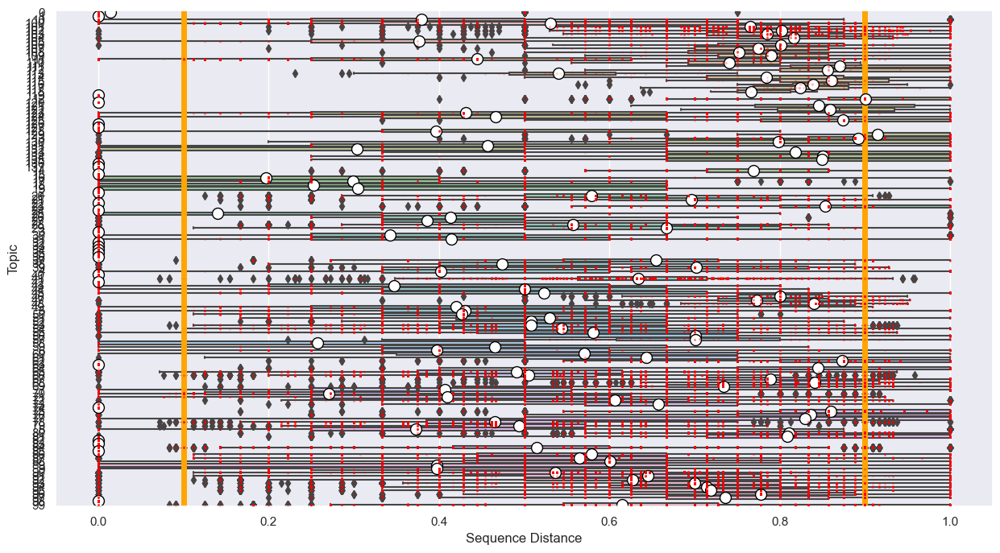

 
****************************************************************************************************
****************************************************************************************************


In [36]:
ClusterAnalysisPlotGroupSelectionCriteria(DATASET_NAME,
                                          learning_activity_sequence_stats_per_group,
                                          seq_distances,
                                          True,
                                          50,
                                          5,
                                          (0.1, 0.9)).display_group_selection_criteria()

In [37]:
cluster_eval = ClusterEvaluation(DATASET_NAME, 
                                 interactions, 
                                 USER_FIELD_NAME_STR, 
                                 GROUP_FIELD_NAME_STR, 
                                 EVALUATION_GROUP_IS_CORRECT_ALL_LEARNING_ACTIVITIES_MEAN_FIELD_NAME_STR,
                                 seq_distances,
                                 True,
                                 50,
                                 5,
                                 (0.1, 0.9),
                                 hdbscan.HDBSCAN,
                                 0.05,
                                 0.05,
                                 0.05,
                                 metric='precomputed',
                                 cluster_selection_method='eom')

In [38]:
cluster_eval.cluster_sequences_and_test_eval_metric_diff()
cluster_eval.aggregate_sequence_clustering_and_eval_metric_diff_test_over_groups()

100%|██████████| 138/138 [00:01<00:00, 89.50it/s]


In [39]:
pickle_write(cluster_eval,
             PATH_TO_SEQUENCE_CLUSTER_EVALUATION_METRIC_ANALYSIS_PICKLE_FOLDER,
             DATASET_NAME + SEQUENCE_CLUSTER_EVALUATION_METRIC_ANALYSIS_PER_GROUP_OBJECT_PICKLE_NAME)

In [40]:
cluster_stats_per_group = cluster_eval.cluster_stats_per_group
cluster_eval_metric_central_tendency_differences_per_group = cluster_eval.cluster_eval_metric_central_tendency_differences_per_group
aggregate_sequence_clustering_and_eval_metric_diff_test = cluster_eval.aggregate_sequence_clustering_and_eval_metric_diff_test
group_cluster_analysis_inclusion_status = cluster_eval.group_cluster_analysis_inclusion_status
min_cluster_size_correction_df = cluster_eval.min_cluster_size_correction_df

In [41]:
cluster_stats_per_group.head(1)

,Dataset Name,Topic,Number of Sequences,Number of Unique Sequences,Percentage Clustered,Cluster,Number of Sequences per Cluster,Number of Unique Sequences per Cluster,User,Sequence ID,Sequence Length,Sequence Array,Mean Evaluation Metric,Median Evaluation Metrice,Min Evaluation Metric Value,Max Evaluation Metric Value,STD Evaluation Metric Value,IQR Evaluation Metric Value
0,kdd_2010,10,183,13,96.721311,-1,6,5,"[133, 194, 35, 47, 92, 96]","[11, 13, 13, 14, 15, 16]","[8, 1, 1, 7, 1, 8]","[(10, 9, 10, 9, 10, 9, 10, 9), (10,), (10,), (...",0.955357,1.0,0.857143,1.0,0.069391,0.09375


In [42]:
cluster_eval_metric_central_tendency_differences_per_group.head(1)

,Dataset Name,Topic,Number of Sequences,Number of Unique Sequences,Mean Normalized Sequence Distance,Median Normalized Sequence Distance,Min Normalized Sequence Distance,Max Normalized Sequence Distance,STD Normalized Sequence Distance,IQR Normalized Sequence Distance,Clustering Algorithm,HDBSCAN Min Cluster Size,Number of Clusters,Percentage Clustered,Mean Cluster Size,Median Cluster Size,Min Cluster Size,Max Cluster Size,STD Cluster Size,IQR Cluster Size,Cluster Comparision Evaluation Metric,Normality Test Shapiro P-Value,Normality Test Jarque-Bera P-Value,Normality Test D'Agostion-Pearson P-Value,Homoscedasticity Test Levene P-Value,Homoscedasticity Test Bartlett P-Value,Central Tendency Differences Test Type,Central Tendency Differences Test P-Value
0,kdd_2010,10,183,13,0.379193,0.333333,0.0,1.0,0.245807,0.25,HDBSCAN,9,6,96.721311,29.5,28.0,16,46,9.305017,8.25,Topic Is Correct All Learning Resources Mean,8.716476e-22,4.744982e-196,4.043141e-29,0.897492,0.0014,kruskal_wallis_test,0.863336


In [43]:
aggregate_sequence_clustering_and_eval_metric_diff_test.head(1)

,Unfiltered Number of Topics,Number of Topics,Percentage of Unfiltered Topics,Number of Topics with Multiple Clusters,Mean Number of Sequences per Topic,Median Number of Sequences per Topic,Min Number of Sequences per Topic,Max Number of Sequences per Topic,STD Number of Sequences per Topic,IQR Number of Sequences per Topic,Mean Number of Unique Sequences per Topic,Median Number of Unique Sequences per Topic,Min Number of Unique Sequences per Topic,Max Number of Unique Sequences per Topic,STD Number of Unique Sequences per Topic,IQR Number of Unique Sequences per Topic,Mean Number of Clusters per Topic,Median Number of Clusters per Topic,Min Number of Clusters per Topic,Max Number of Clusters per Topic,STD Number of Clusters per Topic,IQR Number of Clusters per Topic,Mean Number of Sequences per Topic with Multiple Clusters,Median Number of Sequences per Topic with Multiple Clusters,Min Number of Sequences per Topic with Multiple Clusters,Max Number of Sequences per Topic with Multiple Clusters,STD Number of Sequences per Topic with Multiple Clusters,IQR Number of Sequences per Topic with Multiple Clusters,Mean Number of Unique Sequences per Topic with Multiple Clusters,Median Number of Unique Sequences per Topic with Multiple Clusters,Min Number of Unique Sequences per Topic with Multiple Clusters,Max Number of Unique Sequences per Topic with Multiple Clusters,STD Number of Unique Sequences per Topic with Multiple Clusters,IQR Number of Unique Sequences per Topic with Multiple Clusters,Mean Number of Clusters per Topic with Multiple Clusters,Median Number of Clusters per Topic with Multiple Clusters,Min Number of Clusters per Topic with Multiple Clusters,Max Number of Clusters per Topic with Multiple Clusters,STD Number of Clusters per Topic with Multiple Clusters,IQR Number of Clusters per Topic with Multiple Clusters,Number of Topics Significant Differeces Eval Metric Central Tendencies between Clusters,Percentage of Topics Significant Differeces Eval Metric Central Tendencies between Clusters,Percentage of Topics with Multiple Clusters Significant Differeces Eval Metric Central Tendencies between Clusters
Dataset Name,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
kdd_2010,138,80,0.57971,80,134.3125,154.0,51,225,49.059146,82.75,76.2375,67.5,5,213,59.310221,113.0,4.775,4.5,2,9,2.221728,4.0,134.3125,154.0,51,225,49.059146,82.75,76.2375,67.5,5,213,59.310221,113.0,4.775,4.5,2,9,2.221728,4.0,20,25.0,25.0


In [44]:
group_cluster_analysis_inclusion_status.head(1)

,Dataset Name,Topic,Topic Included in Cluster Analysis,Minium Sequence Number Threshold Value,Minium Sequence Number Violated,Minium Unique Sequence Number Threshold Value,Minium Unique Sequence Number Violated,Sequence Distance Range Threshold Value,Sequence Distance Range Violated
0,kdd_2010,0,False,50,False,5,True,"(0.1, 0.9)",True


In [45]:
min_cluster_size_correction_df.head(1)

,Dataset Name,Topic,Minimum Cluster Size Is Corrected,Uncorrected Minimum Cluster Size,Corrected Minimum Cluster Size
0,kdd_2010,10,False,9,9


****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Cluster Analysis - Included Topics
----------------------------------------------------------------------------------------------------
 
80 Topics out of 138 are included in Cluster Analysis:


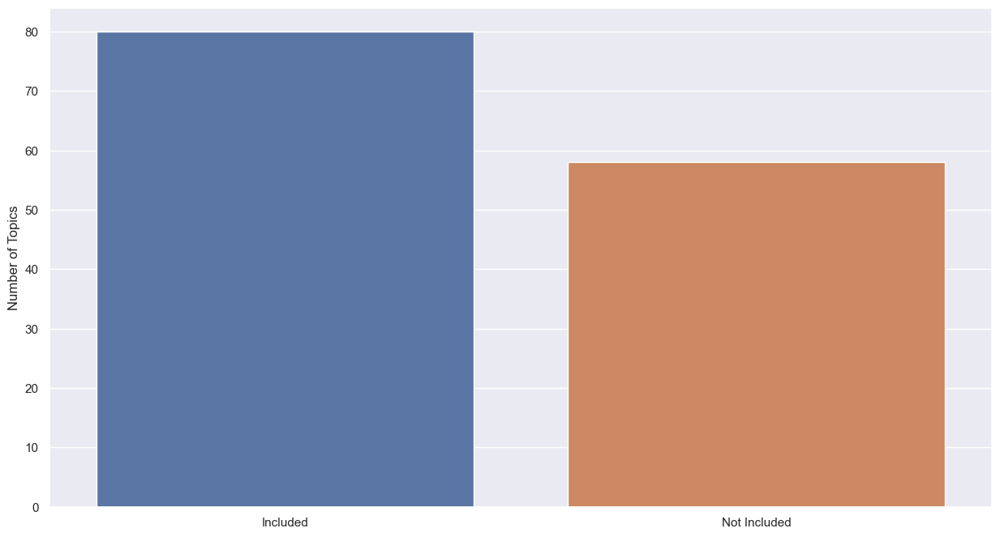

57.971014492753625% of Topics are included in Cluster Analysis:


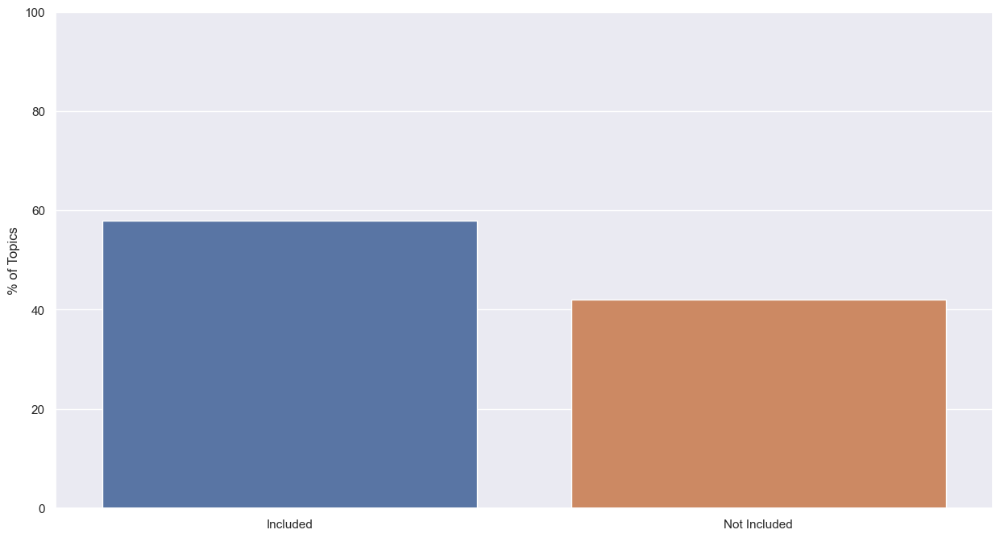

In [46]:
cluster_eval.display_included_groups()

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Clusters per Topic:
----------------------------------------------------------------------------------------------------


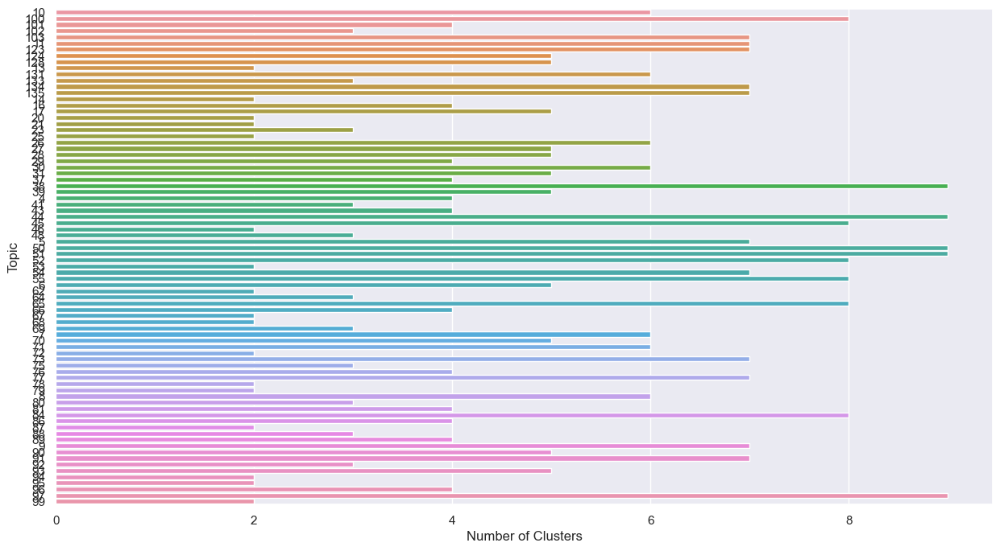

In [47]:
cluster_eval.display_number_of_clusters_all_group()

In [48]:
cluster_eval.print_number_of_clusters_all_group()

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Clusters for each Topic:
----------------------------------------------------------------------------------------------------
Topic  Number of Clusters
   99                   2
   79                   2
   53                   2
   46                   2
   87                   2
   72                   2
   78                   2
   21                   2
   20                   2
   62                   2
   14                   2
   25                   2
   13                   2
   67                   2
   68                   2
   95                   2
   94                   2
   64                   3
   48                   3
  102                   3
   80        

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Min Cluster Size per Topic:
----------------------------------------------------------------------------------------------------


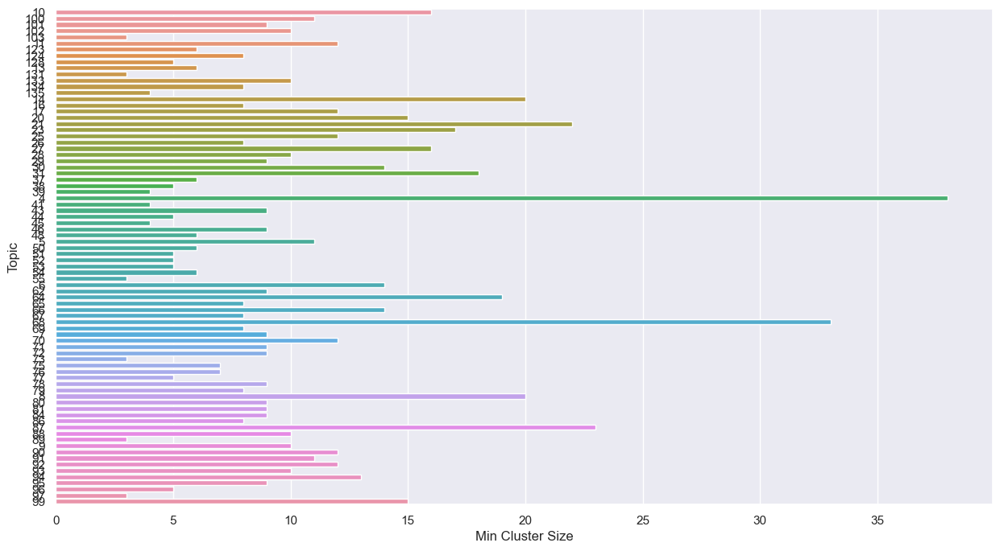

In [49]:
cluster_eval.display_min_cluster_size_all_group()

In [50]:
cluster_eval.print_min_cluster_sizes_all_group()

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Min Cluster Size per Topic:
----------------------------------------------------------------------------------------------------
Topic  Min Cluster Size
   73                 3
   89                 3
  103                 3
   55                 3
   97                 3
  131                 3
   45                 4
   41                 4
   39                 4
  135                 4
   51                 5
   77                 5
   53                 5
   52                 5
   38                 5
   44                 5
  128                 5
   96                 5
  123                 6
   54                 6
   37                 6
   50                 6
   48         

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Percentage Clustered per Topic:
----------------------------------------------------------------------------------------------------


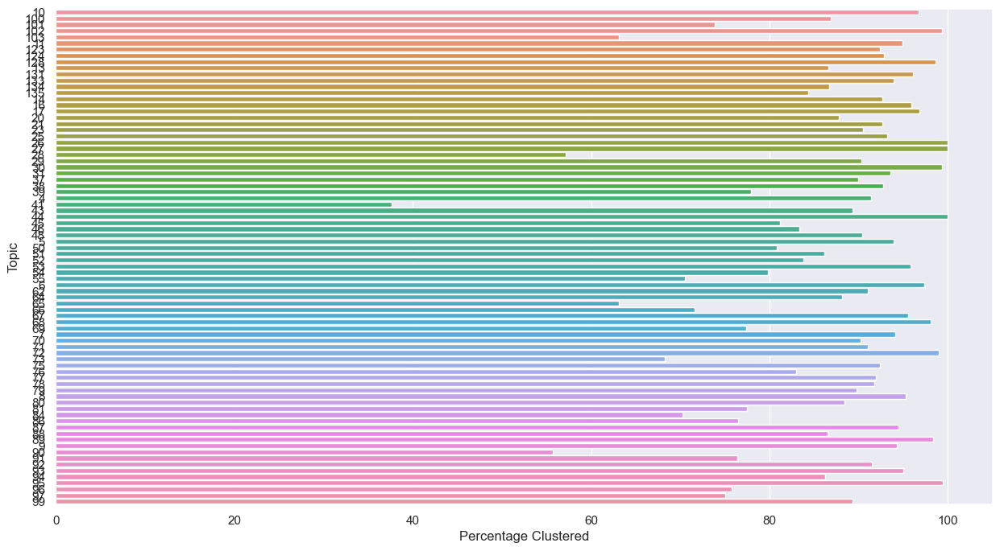

In [51]:
cluster_eval.display_percentage_clustered_all_group()

In [52]:
cluster_eval.print_percentage_clustered_all_group()

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Percentage Clustered per Topic:
----------------------------------------------------------------------------------------------------
Topic  Percentage Clustered
   41             37.647059
   90             55.721393
   28             57.142857
  103             63.076923
   65             63.095238
   73             68.253968
   84             70.238095
   55             70.491803
   66             71.604938
  101             73.885350
   97             75.000000
   96             75.728155
   91             76.410256
   86             76.506024
   69             77.358491
   81             77.514793
   39             77.922078
   54             79.787234
   50             80.808081
  

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Sequences per Cluster for each Topic:
----------------------------------------------------------------------------------------------------
Plots:


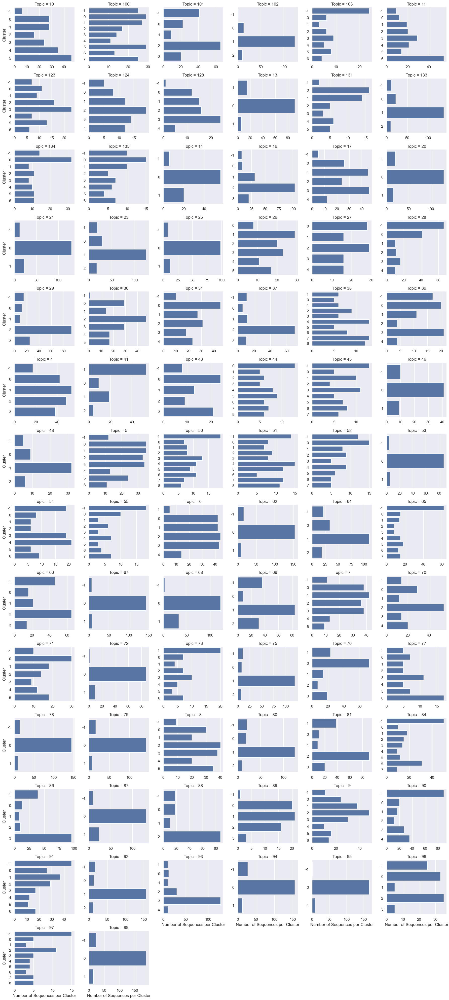

In [53]:
cluster_eval.display_number_sequences_per_cluster_all_group(height=3)

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Unique Sequences per Cluster for each Topic:
----------------------------------------------------------------------------------------------------
Plots:


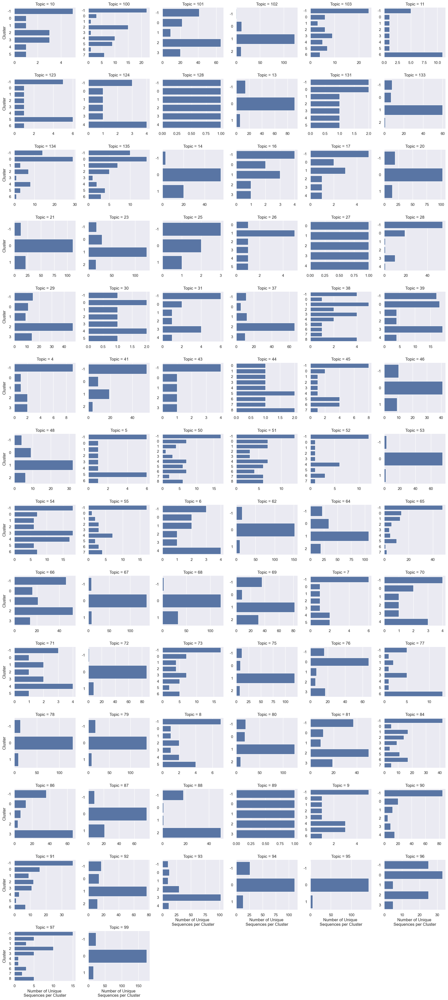

In [54]:
cluster_eval.display_number_unique_sequences_per_cluster_all_group(height=3)

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Unique Sequences vs Number of Sequences per Cluster for each Topic:
----------------------------------------------------------------------------------------------------
Plots:


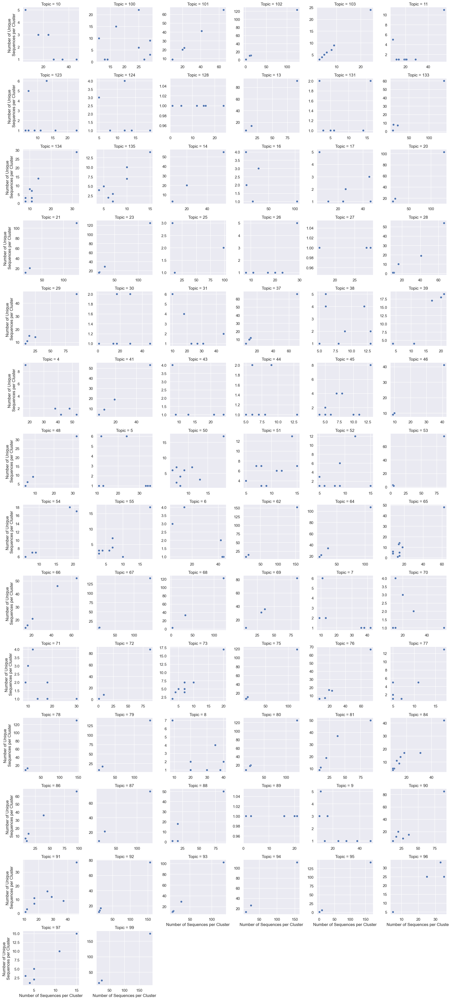

In [55]:
cluster_eval.display_number_unique_sequences_vs_number_sequences_per_cluster_all_group(height=3)

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Central Tendency Differences in Evaluation Metric between Clusters per Topic:
Chosen Evaluation Metric: "Topic Is Correct All Learning Resources Mean"
----------------------------------------------------------------------------------------------------


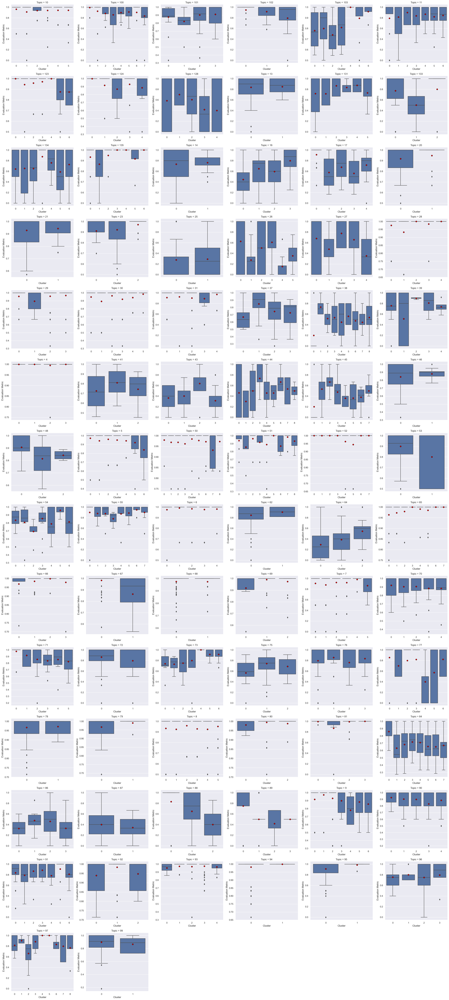

In [56]:
cluster_eval.display_eval_metric_dist_between_cluster_all_groups(height=5)

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Clusters per Topic
Dimensionality Reducer: UMAP
----------------------------------------------------------------------------------------------------


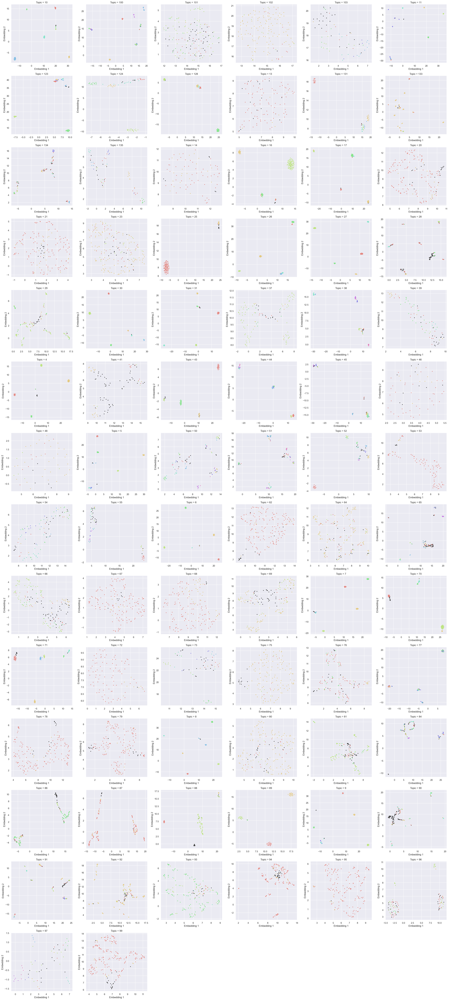

In [57]:
cluster_eval.display_clusters_all_group_umap(height=5)